In [4]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('..')
import model.model_cnnvae_conditional

# import Tensorflow before Pytorch Lightning
import tensorflow as tf
import torchvision
import torch
import lightning.pytorch as pl

from sklearn.decomposition import PCA
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd
import os
import time
from enum import Enum
import pdb
import math
sys.path.append('../../PUPS/') # This external repository is available at https://github.com/uhlerlab/PUPS
from src.dataset.dataset import SubCellDatset, DatasetType, CLASSES
from PIL import Image

import sklearn
import sklearn.ensemble
import sklearn.neighbors
import seaborn as sns
import umap

from src.utils.data_handling_utils import initialize_datasets, Retrieval_Data

fig = plt.figure()
import pickle

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


<Figure size 640x480 with 0 Axes>

In [5]:
testCellLine='U2OS'
from pymongo import MongoClient
COLLECTION_NAME = "splice_isoform_dataset_cell_line_and_gene_split_full"
cell_line_grouping = None
with MongoClient(maxPoolSize=500) as client:
    dataset_collection = client.hpa_old[COLLECTION_NAME]
    cell_line_grouping = list(
        dataset_collection.aggregate(
            [{"$group": {"_id": "$cell_line", "ids": {"$push": "$_id"}}}],
            allowDiskUse=True,
        )
    )
for clidx in cell_line_grouping:
    if clidx['_id'] == testCellLine:
        cellIDbyCellLine=np.array(clidx['ids'])

In [6]:
COLLECTION_NAME = "random_splice_isoform_dataset"
cell_line_grouping_new = None
with MongoClient(maxPoolSize=500) as client:
    dataset_collection = client.hpa[COLLECTION_NAME]
    cell_line_grouping_new = list(
        dataset_collection.aggregate(
            [{"$group": {"_id": "$cell_line", "ids": {"$push": "$_id"}}}],
            allowDiskUse=True,
        )
    )
for clidx in cell_line_grouping_new:
    if clidx['_id'] == testCellLine:
        cellIDbyCellLine_new=np.array(clidx['ids'])

In [10]:
train_dataset, val_dataset, test_dataset, get_data = initialize_datasets("splice_isoform_dataset_cell_line_and_gene_split_full",if_alphabetical=True)
train_dataset_new, val_dataset_new, test_dataset_new, get_data_new = initialize_datasets("random_splice_isoform_dataset",if_alphabetical=False)


In [11]:
COLLECTION_NAME = "splice_isoform_dataset_cell_line_and_gene_split_full"

with MongoClient(maxPoolSize=500) as client:
    dataset_collection = client.hpa_old[COLLECTION_NAME]
    isoform_grouping = list(
        dataset_collection.aggregate(
            [{"$group": {"_id": "$splice_isoform_id", "ids": {"$push": "$_id"}}}],
            allowDiskUse=True,
        )
    )
    
cellIDbyCellLine_pNames=np.array([None]*cellIDbyCellLine.shape[0])
for pidx in range(len(isoform_grouping)):
    pcurr=isoform_grouping[pidx]['_id']
    pcurr=pcurr.split('-')[0]
    cellIDcurr=isoform_grouping[pidx]['ids']
    cellIDcurr,_,cellIdx=np.intersect1d(cellIDcurr,cellIDbyCellLine,return_indices=True)
    if cellIdx.size>0:
        cellIDbyCellLine_pNames[cellIdx]=pcurr

COLLECTION_NAME = "random_splice_isoform_dataset"

with MongoClient(maxPoolSize=500) as client:
    dataset_collection = client.hpa[COLLECTION_NAME]
    isoform_grouping_new = list(
        dataset_collection.aggregate(
            [{"$group": {"_id": "$splice_isoform_id", "ids": {"$push": "$_id"}}}],
            allowDiskUse=True,
        )
    )
    
cellIDbyCellLine_new_pNames=np.array([None]*cellIDbyCellLine_new.shape[0])
for pidx in range(len(isoform_grouping_new)):
    pcurr=isoform_grouping_new[pidx]['_id']
    pcurr=pcurr.split('-')[0]
    cellIDcurr=isoform_grouping_new[pidx]['ids']
    cellIDcurr,_,cellIdx=np.intersect1d(cellIDcurr,cellIDbyCellLine_new,return_indices=True)
    if cellIdx.size>0:
        cellIDbyCellLine_new_pNames[cellIdx]=pcurr

np.unique(cellIDbyCellLine_new_pNames).shape

(488,)

In [12]:
np.unique(cellIDbyCellLine_pNames).shape

(2578,)

(array([2.457e+03, 3.720e+02, 8.100e+01, 3.100e+01, 1.400e+01, 5.000e+00,
        3.000e+00, 3.000e+00, 3.000e+00, 2.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([   3. ,   75.7,  148.4,  221.1,  293.8,  366.5,  439.2,  511.9,
         584.6,  657.3,  730. ,  802.7,  875.4,  948.1, 1020.8, 1093.5,
        1166.2, 1238.9, 1311.6, 1384.3, 1457. , 1529.7, 1602.4, 1675.1,
        1747.8, 1820.5, 1893.2, 1965.9, 2038.6, 2111.3, 2184. ]),
 <BarContainer object of 30 artists>)

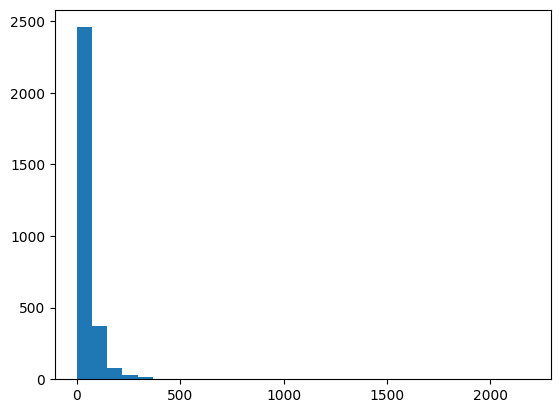

In [13]:
# cellIDbyCellLine_pNamesUnique,pcounts=np.unique(cellIDbyCellLine_pNames,return_counts=True)

cellIDbyCellLine_pNamesUniqueComb,pcounts=np.unique(np.concatenate((cellIDbyCellLine_pNames,cellIDbyCellLine_new_pNames)),return_counts=True)
plt.hist(pcounts,bins=30)

In [14]:
pcounts_min=150
cellIDbyCellLine_pNamesUniqueFiltered=cellIDbyCellLine_pNamesUniqueComb[pcounts>pcounts_min]
cellIDbyCellLine_pNames_filterIdx=np.repeat(False,cellIDbyCellLine_pNames.size)
for pcurr in cellIDbyCellLine_pNamesUniqueFiltered:
    cellIDbyCellLine_pNames_filterIdx[cellIDbyCellLine_pNames==pcurr]=True
cellIDbyCellLine_pNamesFiltered=cellIDbyCellLine_pNames[cellIDbyCellLine_pNames_filterIdx]
cellIDbyCellLine_Filtered=cellIDbyCellLine[cellIDbyCellLine_pNames_filterIdx]
cellIDbyCellLine_Filtered.shape

(36150,)

(array([2.457e+03, 3.720e+02, 8.100e+01, 3.100e+01, 1.400e+01, 5.000e+00,
        3.000e+00, 3.000e+00, 3.000e+00, 2.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([   3. ,   75.7,  148.4,  221.1,  293.8,  366.5,  439.2,  511.9,
         584.6,  657.3,  730. ,  802.7,  875.4,  948.1, 1020.8, 1093.5,
        1166.2, 1238.9, 1311.6, 1384.3, 1457. , 1529.7, 1602.4, 1675.1,
        1747.8, 1820.5, 1893.2, 1965.9, 2038.6, 2111.3, 2184. ]),
 <BarContainer object of 30 artists>)

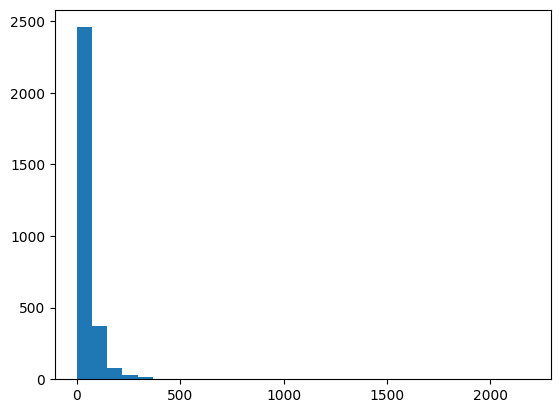

In [15]:
cellIDbyCellLine_new_pNamesUnique,pcounts_new=np.unique(cellIDbyCellLine_new_pNames,return_counts=True)
plt.hist(pcounts,bins=30)

In [16]:
# pcounts_min_new=100
# cellIDbyCellLine_new_pNamesUniqueFiltered=cellIDbyCellLine_new_pNamesUnique[pcounts_new>pcounts_min_new]
cellIDbyCellLine_pNames_new_filterIdx=np.repeat(False,cellIDbyCellLine_new_pNames.size)
for pcurr in cellIDbyCellLine_pNamesUniqueFiltered:
    cellIDbyCellLine_pNames_new_filterIdx[cellIDbyCellLine_new_pNames==pcurr]=True
cellIDbyCellLine_new_pNamesFiltered=cellIDbyCellLine_new_pNames[cellIDbyCellLine_pNames_new_filterIdx]
cellIDbyCellLine_new_Filtered=cellIDbyCellLine_new[cellIDbyCellLine_pNames_new_filterIdx]
cellIDbyCellLine_new_Filtered.shape

(1524,)

In [17]:
np.unique(cellIDbyCellLine_new_pNamesFiltered)

array(['ABI1', 'AKIP1', 'ANAPC15', 'ARL6IP4', 'C11orf1', 'C19orf25',
       'C8orf59', 'CFAP298', 'CITED1', 'CLCC1', 'DDX3X', 'DNAJC7',
       'DNMT3B', 'EIF3G', 'EIF4A1', 'EIF4G1', 'ETFB', 'EYA1', 'FHL2',
       'HNRNPC', 'HNRNPK', 'NR2C2'], dtype=object)

In [21]:
np.unique(np.concatenate((cellIDbyCellLine_pNamesFiltered,cellIDbyCellLine_new_pNamesFiltered))).size

141

In [22]:
cellIDbyCellLine_pNamesUniqueFiltered.size

141

In [23]:
cellIDbyCellLine_pNamesUniqueComb.size

2973

In [24]:
#get images
nsamples_all=cellIDbyCellLine_Filtered.size+cellIDbyCellLine_new_Filtered.size
allImages=np.zeros((nsamples_all,3,128,128))
allPnames=np.concatenate((cellIDbyCellLine_pNamesFiltered,cellIDbyCellLine_new_pNamesFiltered))
for i in range(cellIDbyCellLine_Filtered.size):
    if i%500==0:
        print(i)
    allImages[i]=get_data(cellIDbyCellLine_Filtered[i],Retrieval_Data.CELL_IMAGE)
for i in range(cellIDbyCellLine_new_Filtered.size):
    allImages[i+cellIDbyCellLine_Filtered.size]=get_data_new(cellIDbyCellLine_new_Filtered[i],Retrieval_Data.CELL_IMAGE)
    

In [ ]:
#get protein images
allProteinImages=np.zeros((nsamples_all,128,128))
for i in range(cellIDbyCellLine_Filtered.size):
    if i%500==0:
        print(i)
    allProteinImages[i]=get_data(cellIDbyCellLine_Filtered[i],Retrieval_Data.TRUE_LABELS)[1]
for i in range(cellIDbyCellLine_new_Filtered.size):
    allProteinImages[i+cellIDbyCellLine_Filtered.size]=get_data_new(cellIDbyCellLine_new_Filtered[i],Retrieval_Data.TRUE_LABELS)[1]
    

### train

In [25]:
sharedSizes=[512]
dSpecific_filter=[(100,16)]
pID_type='randInit'
seed=3
c=0
p=1

In [26]:
#train-test split
np.random.seed(3)
pctVal=0.05
pctTest=0.1

allIdx_all=np.arange(nsamples_all)
np.random.shuffle(allIdx_all)
valIdx_all=allIdx_all[:int(pctVal*nsamples_all)]
testIdx_all=allIdx_all[int(pctVal*nsamples_all):(int(pctVal*nsamples_all)+int(pctTest*nsamples_all))]
trainIdx_all=allIdx_all[(int(pctVal*nsamples_all)+int(pctTest*nsamples_all)):]



In [27]:
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

#VAE settings
epochs=4250
saveFreq=850
lr_latent=0.001 #initial learning rate
lr_decoder=0.0001
weight_decay=0 #Weight for L2 loss on embedding matrix.

# batchsize=4
batchsize=256
kernel_size=4
stride=2
padding=1

hidden1=64 
hidden2=128 
hidden3=256
hidden4=256
hidden5=96
hidden5_xy=4
fc_dim1=96*hidden5_xy*hidden5_xy

dropout=0.01




In [28]:
printFreq=1
trainIdx=trainIdx_all
imgsC_all=allImages[:,[c]]
imgsP_all=allImages[:,[p]]
def train(epoch):
    t = time.time()
    modelcnn_dna.train()
    modelcnn_protein.train()

    loss_x_train_all_dna=0
    loss_x_train_all_protein=0
    loss_lNorm_all=0
    loss_lNorm_all_dna=0
    loss_lNorm_all_protein=0
    loss_all=0
    ntrainBatches=int(np.ceil(trainIdx.shape[0]/batchsize))
    for i in range(ntrainBatches):
#         if i%200==0:
#         print(i)
        trainIdx_i=trainIdx[i*batchsize:min((i+1)*batchsize,trainIdx.shape[0])]
        traintarget_protein=torch.tensor(imgsP_all[trainIdx_i]).cuda().float()
        traintarget_dna=torch.tensor(imgsC_all[trainIdx_i]).cuda().float()
        trainIdx_i=torch.tensor(trainIdx_i)
        trainInput_shared=latent_shared(trainIdx_i).cuda().float()
        trainInput_dna=latent_dna(trainIdx_i).cuda().float()
        trainInput_protein=latent_protein(trainIdx_i).cuda().float()
        if addNoise:
            trainInput_shared=trainInput_shared+torch.randn_like(trainInput_shared)
            trainInput_dna=trainInput_dna+torch.randn_like(trainInput_dna)
            trainInput_protein=trainInput_protein+torch.randn_like(trainInput_protein)
#         print(trainInput.shape)

        optimizer_dna.zero_grad()
        optimizer_protein.zero_grad()
        optimizer_latent.zero_grad()

        recon_dna= modelcnn_dna(torch.cat((trainInput_shared,trainInput_dna),dim=1))
        recon_protein= modelcnn_protein(torch.cat((trainInput_shared,trainInput_protein),dim=1))
        
        loss_x_train_protein=loss_x(recon_protein, traintarget_protein)
        loss_x_train_dna=loss_x(recon_dna, traintarget_dna)
        
        loss=loss_x_train_protein+loss_x_train_dna
        if addNoise:
            loss_lNorm=torch.mean(torch.linalg.norm(latent_shared(trainIdx_i).cuda(),dim=1))/latent_shared.embedding_dim
            loss_lNorm_all+=loss_lNorm.item()
            loss+=loss_lNorm*actDecay
            
            loss_lNorm_dna=torch.mean(torch.linalg.norm(latent_dna(trainIdx_i).cuda(),dim=1))/latent_dna.embedding_dim
            loss_lNorm_all_dna+=loss_lNorm_dna.item()
            loss+=loss_lNorm_dna*actDecay
            
            loss_lNorm_protein=torch.mean(torch.linalg.norm(latent_protein(trainIdx_i).cuda(),dim=1))/latent_protein.embedding_dim
            loss_lNorm_all_protein+=loss_lNorm_protein.item()
            loss+=loss_lNorm_protein*actDecay
        
        loss_x_train_all_dna+=loss_x_train_dna.item()
        loss_x_train_all_protein+=loss_x_train_protein.item()
        loss_all+=loss.item()
        
        loss.backward()
        optimizer_dna.step()
        optimizer_protein.step()
        optimizer_latent.step()


    loss_x_train_all_dna=loss_x_train_all_dna/ntrainBatches
    loss_x_train_all_protein=loss_x_train_all_protein/ntrainBatches
    loss_all=loss_all/ntrainBatches
    if addNoise:
        loss_lNorm_all=loss_lNorm_all/ntrainBatches
        loss_lNorm_all_dna=loss_lNorm_all_dna/ntrainBatches
        loss_lNorm_all_protein=loss_lNorm_all_protein/ntrainBatches




    if epoch%printFreq==0:
        print('Epoch: {:04d}'.format(epoch),
              'loss_train: {:.4f}'.format(loss_all),
              'loss_x_train_dna: {:.4f}'.format(loss_x_train_all_dna),
              'loss_x_train_protein: {:.4f}'.format(loss_x_train_all_protein),
              'time: {:.4f}s'.format(time.time() - t))
    return loss_all,loss_x_train_all_dna,loss_x_train_all_protein,loss_lNorm_all,loss_lNorm_all_dna,loss_lNorm_all_protein

In [30]:
match_weight=1
sharedWeight=1
addNoise=True
actDecay=0.001
name_train='nuc_microtubule_noSharedRecon_all'
modelname_train='hpa_lord'
logsavepath_train=os.path.join('/mnt/d2/xinyi/c2p/hpa/log/',modelname_train,name_train)
modelsavepath_train=os.path.join('/mnt/d2/xinyi/c2p/hpa/models/',modelname_train,name_train)
plotsavepath_train=os.path.join('/mnt/d2/xinyi/c2p/hpa/plots/',modelname_train,name_train)

if not os.path.exists(os.path.join('/mnt/d2/xinyi/c2p/hpa/log/',modelname_train)):
    os.mkdir(os.path.join('/mnt/d2/xinyi/c2p/hpa/log/',modelname_train))
    os.mkdir(os.path.join('/mnt/d2/xinyi/c2p/hpa/models/',modelname_train))
    os.mkdir(os.path.join('/mnt/d2/xinyi/c2p/hpa/plots/',modelname_train))
if not os.path.exists(logsavepath_train):
    os.mkdir(logsavepath_train)
    os.mkdir(os.path.join(logsavepath_train,'dna'))
    os.mkdir(os.path.join(logsavepath_train,'protein'))
if not os.path.exists(modelsavepath_train):
    os.mkdir(modelsavepath_train)
    os.mkdir(os.path.join(modelsavepath_train,'dna'))
    os.mkdir(os.path.join(modelsavepath_train,'protein'))
if not os.path.exists(plotsavepath_train):
    os.mkdir(plotsavepath_train)
    os.mkdir(os.path.join(plotsavepath_train,'dna'))
    os.mkdir(os.path.join(plotsavepath_train,'protein'))




In [152]:

logsavepath_p_dna=os.path.join(logsavepath_train,'dna')
modelsavepath_p_dna=os.path.join(modelsavepath_train,'dna')
plotsavepath_p_dna=os.path.join(plotsavepath_train,'dna')
if not os.path.exists(logsavepath_p_dna):
    os.mkdir(logsavepath_p_dna)
if not os.path.exists(modelsavepath_p_dna):
    os.mkdir(modelsavepath_p_dna)
if not os.path.exists(plotsavepath_p_dna):
    os.mkdir(plotsavepath_p_dna)

logsavepath_p_protein=os.path.join(logsavepath_train,'protein')
modelsavepath_p_protein=os.path.join(modelsavepath_train,'protein')
plotsavepath_p_protein=os.path.join(plotsavepath_train,'protein')
if not os.path.exists(logsavepath_p_protein):
    os.mkdir(logsavepath_p_protein)
if not os.path.exists(modelsavepath_p_protein):
    os.mkdir(modelsavepath_p_protein)
if not os.path.exists(plotsavepath_p_protein):
    os.mkdir(plotsavepath_p_protein)



for currLatentSize in sharedSizes:
    for dSpecificSize,dfilterSize in dSpecific_filter:
        latent_curr=None


        print(currLatentSize)
        print(dSpecificSize)
        dna_cShared=hidden5-dfilterSize
        p_cShared=dna_cShared

        loss_x=torch.nn.BCEWithLogitsLoss()

        np.random.seed(seed)
        torch.manual_seed(seed)
        torch.cuda.manual_seed(seed)
        torch.backends.cudnn.enabled = True
        if modelname_train=='hpa_lord':
            modelcnn_dna = model.model_cnnvae_conditional.CNN_VAE_decode(kernel_size, stride, padding, 1, hidden1, hidden2, hidden3, hidden4, hidden5, fc_dim1,currLatentSize+dSpecificSize,applySigmoid=False)
            modelcnn_protein = model.model_cnnvae_conditional.CNN_VAE_decode(kernel_size, stride, padding, 1, hidden1, hidden2, hidden3, hidden4, hidden5, fc_dim1,currLatentSize+dSpecificSize,applySigmoid=False)
        modelcnn_dna.cuda()
        modelcnn_protein.cuda()

        optimizer_dna = torch.optim.Adam(modelcnn_dna.parameters(), lr=lr_decoder, weight_decay=weight_decay)
        optimizer_protein = torch.optim.Adam(modelcnn_protein.parameters(), lr=lr_decoder, weight_decay=weight_decay)

        train_loss=[np.inf]*(epochs)
        train_loss_x_dna=[np.inf]*(epochs)
        train_loss_x_protein=[np.inf]*(epochs)
        
        train_lNorm=[np.inf]*(epochs)
        train_lNorm_dna=[np.inf]*(epochs)
        train_lNorm_protein=[np.inf]*(epochs)

        t_ep=time.time()

        stateDict_train_dna={}
        stateDict_train_protein={}
        
        latent_shared=torch.nn.Embedding(nsamples_all,currLatentSize)
        latent_protein=torch.nn.Embedding(nsamples_all,dSpecificSize)
        latent_dna=torch.nn.Embedding(nsamples_all,dSpecificSize)
        optimizer_latent= torch.optim.Adam([latent_shared.weight,latent_protein.weight,latent_dna.weight], lr=lr_latent, weight_decay=weight_decay)

for ep in range(epochs):
    train_loss[ep],train_loss_x_dna[ep],train_loss_x_protein[ep],train_lNorm[ep],train_lNorm_dna[ep],train_lNorm_protein[ep]=train(ep)


    if ep%saveFreq == (saveFreq-1):
        stateDict_train_dna[ep]=modelcnn_dna.cpu().state_dict()
        stateDict_train_protein[ep]=modelcnn_protein.cpu().state_dict()
        with open(os.path.join(modelsavepath_p_dna,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
            pickle.dump(latent_dna.weight, output, pickle.HIGHEST_PROTOCOL)
        with open(os.path.join(modelsavepath_p_dna,'latentShared_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
            pickle.dump(latent_shared.weight, output, pickle.HIGHEST_PROTOCOL)
        with open(os.path.join(modelsavepath_p_protein,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
            pickle.dump(latent_protein.weight, output, pickle.HIGHEST_PROTOCOL)


    modelcnn_dna.cuda()
    modelcnn_protein.cuda()
    torch.cuda.empty_cache()
print(' total time: {:.4f}s'.format(time.time() - t_ep))

with open(os.path.join(modelsavepath_p_dna,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(stateDict_train_dna, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(modelsavepath_p_protein,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(stateDict_train_protein, output, pickle.HIGHEST_PROTOCOL)

with open(os.path.join(logsavepath_p_dna,'train_loss_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_dna,'train_loss_x_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss_x_dna, output, pickle.HIGHEST_PROTOCOL)


with open(os.path.join(logsavepath_p_protein,'train_loss_x_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss_x_protein, output, pickle.HIGHEST_PROTOCOL)

with open(os.path.join(logsavepath_p_dna,'train_lNorm_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_dna,'train_lNormDNA_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm_dna, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_protein,'train_lNormProtein_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm_protein, output, pickle.HIGHEST_PROTOCOL)


plt.plot(np.arange(epochs),train_loss_x_dna)
# plt.plot(np.arange(epochs),train_loss_kl_ep)
plt.legend(['training x recon loss','validation x recon loss','training kl loss'],loc='upper right')
plt.savefig(os.path.join(plotsavepath_p_dna,'loss_seed_x'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'.jpg'))
plt.show()


plt.plot(np.arange(epochs),train_loss_x_protein)
# plt.plot(np.arange(epochs),train_loss_kl_ep)
plt.legend(['training x recon loss','validation x recon loss','training kl loss'],loc='upper right')
plt.savefig(os.path.join(plotsavepath_p_protein,'loss_seed_x'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'.jpg'))
plt.show()



Epoch: 0850 loss_train: 0.3853 loss_x_train_dna: 0.1313 loss_x_train_protein: 0.2535 time: 17.6511s
Epoch: 0851 loss_train: 0.3852 loss_x_train_dna: 0.1313 loss_x_train_protein: 0.2535 time: 18.2033s
Epoch: 0852 loss_train: 0.3852 loss_x_train_dna: 0.1313 loss_x_train_protein: 0.2534 time: 17.9968s
Epoch: 0853 loss_train: 0.3851 loss_x_train_dna: 0.1313 loss_x_train_protein: 0.2534 time: 18.2897s
Epoch: 0854 loss_train: 0.3850 loss_x_train_dna: 0.1312 loss_x_train_protein: 0.2534 time: 17.6928s
Epoch: 0855 loss_train: 0.3850 loss_x_train_dna: 0.1312 loss_x_train_protein: 0.2533 time: 19.0772s
Epoch: 0856 loss_train: 0.3850 loss_x_train_dna: 0.1312 loss_x_train_protein: 0.2533 time: 19.8066s
Epoch: 0857 loss_train: 0.3850 loss_x_train_dna: 0.1312 loss_x_train_protein: 0.2533 time: 20.0974s
Epoch: 0858 loss_train: 0.3850 loss_x_train_dna: 0.1313 loss_x_train_protein: 0.2533 time: 20.4488s
Epoch: 0859 loss_train: 0.3849 loss_x_train_dna: 0.1312 loss_x_train_protein: 0.2532 time: 20.1765s


Epoch: 0932 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 33.2524s
Epoch: 0933 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 32.6455s
Epoch: 0934 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 33.9361s
Epoch: 0935 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 33.5356s
Epoch: 0936 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 32.2237s
Epoch: 0937 loss_train: 0.3832 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 31.8995s
Epoch: 0938 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 33.4363s
Epoch: 0939 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 32.4197s
Epoch: 0940 loss_train: 0.3833 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 34.0375s
Epoch: 0941 loss_train: 0.3832 loss_x_train_dna: 0.1307 loss_x_train_protein: 0.2521 time: 33.1332s


Epoch: 1014 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.9045s
Epoch: 1015 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.1870s
Epoch: 1016 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.2909s
Epoch: 1017 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 32.2787s
Epoch: 1018 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.5845s
Epoch: 1019 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.8992s
Epoch: 1020 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 33.6269s
Epoch: 1021 loss_train: 0.3819 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2510 time: 32.6255s
Epoch: 1022 loss_train: 0.3818 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2509 time: 31.5402s
Epoch: 1023 loss_train: 0.3818 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2509 time: 33.2660s


Epoch: 1096 loss_train: 0.3809 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2502 time: 32.9638s
Epoch: 1097 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2502 time: 31.8222s
Epoch: 1098 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 33.4063s
Epoch: 1099 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 33.8141s
Epoch: 1100 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 33.0045s
Epoch: 1101 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 32.4362s
Epoch: 1102 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 33.3756s
Epoch: 1103 loss_train: 0.3808 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 32.7611s
Epoch: 1104 loss_train: 0.3807 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 34.1279s
Epoch: 1105 loss_train: 0.3807 loss_x_train_dna: 0.1302 loss_x_train_protein: 0.2501 time: 33.3798s


Epoch: 1178 loss_train: 0.3800 loss_x_train_dna: 0.1301 loss_x_train_protein: 0.2494 time: 32.0532s
Epoch: 1179 loss_train: 0.3800 loss_x_train_dna: 0.1301 loss_x_train_protein: 0.2494 time: 33.1310s
Epoch: 1180 loss_train: 0.3799 loss_x_train_dna: 0.1301 loss_x_train_protein: 0.2493 time: 33.4378s
Epoch: 1181 loss_train: 0.3799 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2493 time: 33.8575s
Epoch: 1182 loss_train: 0.3798 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2493 time: 31.8902s
Epoch: 1183 loss_train: 0.3798 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2493 time: 31.7876s
Epoch: 1184 loss_train: 0.3798 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2493 time: 33.1462s
Epoch: 1185 loss_train: 0.3798 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2493 time: 32.6053s
Epoch: 1186 loss_train: 0.3799 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2494 time: 32.0406s
Epoch: 1187 loss_train: 0.3800 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2495 time: 33.0878s


Epoch: 1260 loss_train: 0.3795 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2492 time: 32.9273s
Epoch: 1261 loss_train: 0.3795 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2492 time: 32.0873s
Epoch: 1262 loss_train: 0.3795 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2492 time: 30.3862s
Epoch: 1263 loss_train: 0.3794 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2491 time: 32.4745s
Epoch: 1264 loss_train: 0.3794 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2491 time: 31.7553s
Epoch: 1265 loss_train: 0.3794 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2490 time: 31.1138s
Epoch: 1266 loss_train: 0.3794 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2491 time: 32.4902s
Epoch: 1267 loss_train: 0.3793 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2490 time: 31.8427s
Epoch: 1268 loss_train: 0.3793 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2490 time: 33.5766s
Epoch: 1269 loss_train: 0.3793 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2490 time: 33.2896s


Epoch: 1342 loss_train: 0.3784 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2483 time: 32.6774s
Epoch: 1343 loss_train: 0.3784 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2482 time: 30.9482s
Epoch: 1344 loss_train: 0.3784 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2482 time: 95.1322s
Epoch: 1345 loss_train: 0.3783 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2482 time: 83.5677s
Epoch: 1346 loss_train: 0.3783 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2481 time: 105.4416s
Epoch: 1347 loss_train: 0.3782 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2481 time: 89.5800s
Epoch: 1348 loss_train: 0.3782 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2480 time: 99.2527s
Epoch: 1349 loss_train: 0.3782 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2480 time: 101.6032s
Epoch: 1350 loss_train: 0.3782 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2480 time: 99.0867s
Epoch: 1351 loss_train: 0.3782 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2480 time: 69.8302

Epoch: 1427 loss_train: 0.3786 loss_x_train_dna: 0.1305 loss_x_train_protein: 0.2475 time: 32.9804s
Epoch: 1428 loss_train: 0.3785 loss_x_train_dna: 0.1305 loss_x_train_protein: 0.2475 time: 31.7811s
Epoch: 1429 loss_train: 0.3786 loss_x_train_dna: 0.1305 loss_x_train_protein: 0.2475 time: 32.1795s
Epoch: 1430 loss_train: 0.3785 loss_x_train_dna: 0.1304 loss_x_train_protein: 0.2476 time: 31.9139s
Epoch: 1431 loss_train: 0.3786 loss_x_train_dna: 0.1305 loss_x_train_protein: 0.2476 time: 31.6406s
Epoch: 1432 loss_train: 0.3784 loss_x_train_dna: 0.1303 loss_x_train_protein: 0.2476 time: 31.4423s
Epoch: 1433 loss_train: 0.3782 loss_x_train_dna: 0.1301 loss_x_train_protein: 0.2475 time: 31.7627s
Epoch: 1434 loss_train: 0.3781 loss_x_train_dna: 0.1301 loss_x_train_protein: 0.2475 time: 31.8351s
Epoch: 1435 loss_train: 0.3781 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2475 time: 32.0665s
Epoch: 1436 loss_train: 0.3780 loss_x_train_dna: 0.1300 loss_x_train_protein: 0.2475 time: 32.0760s


Epoch: 1509 loss_train: 0.3778 loss_x_train_dna: 0.1296 loss_x_train_protein: 0.2476 time: 32.4034s
Epoch: 1510 loss_train: 0.3777 loss_x_train_dna: 0.1296 loss_x_train_protein: 0.2476 time: 33.0865s
Epoch: 1511 loss_train: 0.3777 loss_x_train_dna: 0.1296 loss_x_train_protein: 0.2475 time: 33.0814s
Epoch: 1512 loss_train: 0.3776 loss_x_train_dna: 0.1296 loss_x_train_protein: 0.2474 time: 32.9353s
Epoch: 1513 loss_train: 0.3776 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2474 time: 31.9970s
Epoch: 1514 loss_train: 0.3775 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2473 time: 32.1068s
Epoch: 1515 loss_train: 0.3775 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2473 time: 31.6679s
Epoch: 1516 loss_train: 0.3775 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2473 time: 32.2012s
Epoch: 1517 loss_train: 0.3775 loss_x_train_dna: 0.1297 loss_x_train_protein: 0.2472 time: 33.5648s
Epoch: 1518 loss_train: 0.3775 loss_x_train_dna: 0.1298 loss_x_train_protein: 0.2472 time: 32.3626s


Epoch: 1591 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2467 time: 32.8712s
Epoch: 1592 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 32.8846s
Epoch: 1593 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 33.5843s
Epoch: 1594 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 32.6765s
Epoch: 1595 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 34.1443s
Epoch: 1596 loss_train: 0.3765 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 32.2588s
Epoch: 1597 loss_train: 0.3764 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 32.1734s
Epoch: 1598 loss_train: 0.3764 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2466 time: 33.5121s
Epoch: 1599 loss_train: 0.3764 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2465 time: 32.1689s
Epoch: 1600 loss_train: 0.3764 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2465 time: 32.5039s


Epoch: 1673 loss_train: 0.3762 loss_x_train_dna: 0.1294 loss_x_train_protein: 0.2462 time: 31.8293s
Epoch: 1674 loss_train: 0.3762 loss_x_train_dna: 0.1294 loss_x_train_protein: 0.2462 time: 32.8997s
Epoch: 1675 loss_train: 0.3761 loss_x_train_dna: 0.1294 loss_x_train_protein: 0.2462 time: 31.9275s
Epoch: 1676 loss_train: 0.3761 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2462 time: 32.6306s
Epoch: 1677 loss_train: 0.3761 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2462 time: 31.7249s
Epoch: 1678 loss_train: 0.3761 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2462 time: 32.4114s
Epoch: 1679 loss_train: 0.3760 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2462 time: 34.4005s
Epoch: 1680 loss_train: 0.3760 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2461 time: 32.0529s
Epoch: 1681 loss_train: 0.3760 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2461 time: 31.8768s
Epoch: 1682 loss_train: 0.3760 loss_x_train_dna: 0.1293 loss_x_train_protein: 0.2461 time: 32.4634s


Epoch: 1755 loss_train: 0.3757 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2459 time: 32.2977s
Epoch: 1756 loss_train: 0.3758 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2460 time: 32.6146s
Epoch: 1757 loss_train: 0.3759 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2461 time: 32.7309s
Epoch: 1758 loss_train: 0.3760 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2463 time: 32.8822s
Epoch: 1759 loss_train: 0.3762 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2464 time: 31.9878s
Epoch: 1760 loss_train: 0.3759 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2461 time: 33.4914s
Epoch: 1761 loss_train: 0.3758 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2460 time: 34.0206s
Epoch: 1762 loss_train: 0.3757 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2460 time: 33.2512s
Epoch: 1763 loss_train: 0.3757 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2459 time: 33.3901s
Epoch: 1764 loss_train: 0.3757 loss_x_train_dna: 0.1292 loss_x_train_protein: 0.2459 time: 31.6775s


KeyboardInterrupt: 

In [153]:
stateDict_train_dna[ep]=modelcnn_dna.cpu().state_dict()
stateDict_train_protein[ep]=modelcnn_protein.cpu().state_dict()
with open(os.path.join(modelsavepath_p_dna,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
    pickle.dump(latent_dna.weight, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(modelsavepath_p_dna,'latentShared_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
    pickle.dump(latent_shared.weight, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(modelsavepath_p_protein,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(ep)), 'wb') as output:
    pickle.dump(latent_protein.weight, output, pickle.HIGHEST_PROTOCOL)


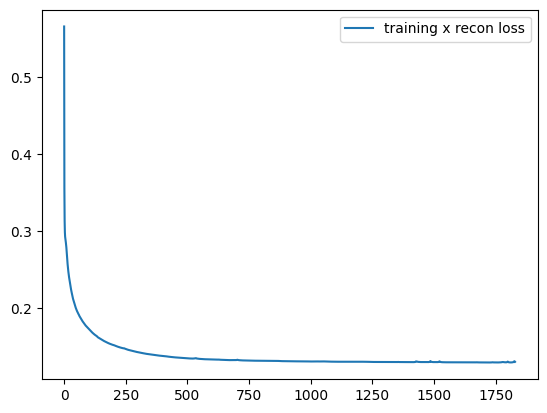

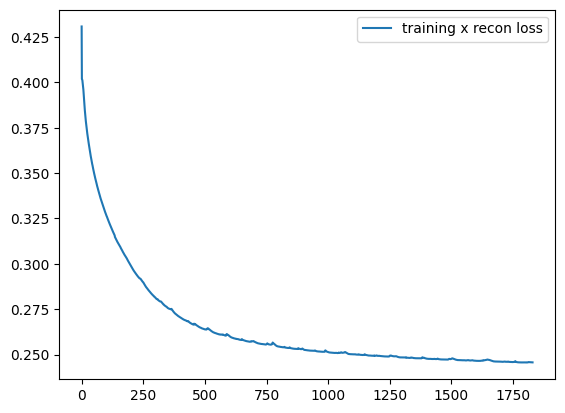

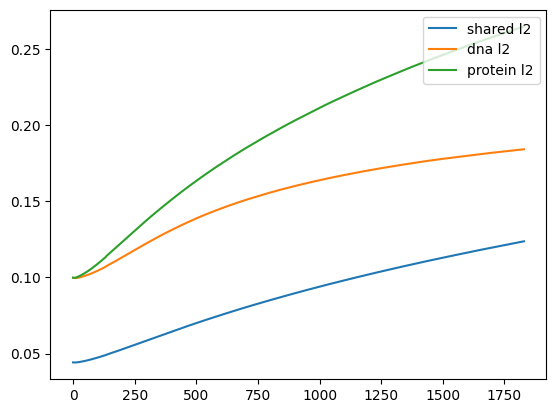

In [154]:
with open(os.path.join(modelsavepath_p_dna,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(stateDict_train_dna, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(modelsavepath_p_protein,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(stateDict_train_protein, output, pickle.HIGHEST_PROTOCOL)

with open(os.path.join(logsavepath_p_dna,'train_loss_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_dna,'train_loss_x_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss_x_dna, output, pickle.HIGHEST_PROTOCOL)

with open(os.path.join(logsavepath_p_protein,'train_loss_x_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_loss_x_protein, output, pickle.HIGHEST_PROTOCOL)
    
with open(os.path.join(logsavepath_p_dna,'train_lNorm_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_dna,'train_lNormDNA_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm_dna, output, pickle.HIGHEST_PROTOCOL)
with open(os.path.join(logsavepath_p_protein,'train_lNormProtein_'+str(currLatentSize)+'_'+str(seed)), 'wb') as output:
    pickle.dump(train_lNorm_protein, output, pickle.HIGHEST_PROTOCOL)


plt.plot(np.arange(epochs),train_loss_x_dna)
# plt.plot(np.arange(epochs),train_loss_kl_ep)
plt.legend(['training x recon loss','validation x recon loss','training kl loss'],loc='upper right')
plt.savefig(os.path.join(plotsavepath_p_dna,'loss_seed3_x'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'.jpg'))
plt.show()


plt.plot(np.arange(epochs),train_loss_x_protein)
# plt.plot(np.arange(epochs),train_loss_kl_ep)
plt.legend(['training x recon loss','validation x recon loss','training kl loss'],loc='upper right')
plt.savefig(os.path.join(plotsavepath_p_protein,'loss_seed3_x'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'.jpg'))
plt.show()

plt.plot(np.arange(epochs),train_lNorm)
plt.plot(np.arange(epochs),train_lNorm_dna)
plt.plot(np.arange(epochs),train_lNorm_protein)
plt.legend(['shared l2','dna l2','protein l2'],loc='upper right')
plt.savefig(os.path.join(plotsavepath_p_dna,'loss_seed3_lNorm'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'.jpg'))
plt.show()


In [31]:
loadEpoch='1830'
modelsavepath_p_dna=os.path.join(modelsavepath_train,'dna')
modelsavepath_p_protein=os.path.join(modelsavepath_train,'protein')
for currLatentSize in sharedSizes:
    for dSpecificSize,dfilterSize in dSpecific_filter:
        latent_curr=None
#         if sIdx==0:
#             continue


        print(currLatentSize)
        print(dSpecificSize)
        dna_cShared=hidden5-dfilterSize
        p_cShared=dna_cShared


        np.random.seed(seed)
        torch.manual_seed(seed)
        torch.cuda.manual_seed(seed)
        torch.backends.cudnn.enabled = True
        if modelname_train=='hpa_lord':
            modelcnn_dna_dec = model.model_cnnvae_conditional.CNN_VAE_decode(kernel_size, stride, padding, 1, hidden1, hidden2, hidden3, hidden4, hidden5, fc_dim1,currLatentSize+dSpecificSize,applySigmoid=False)
            modelcnn_protein_dec = model.model_cnnvae_conditional.CNN_VAE_decode(kernel_size, stride, padding, 1, hidden1, hidden2, hidden3, hidden4, hidden5, fc_dim1,currLatentSize+dSpecificSize,applySigmoid=False)
        modelcnn_dna_dec.cuda().eval()
        modelcnn_protein_dec.cuda().eval()
        
        latent_shared_dec=torch.nn.Embedding(nsamples_all,currLatentSize)
        
        latent_protein_dec=torch.nn.Embedding(nsamples_all,dSpecificSize)
        latent_dna_dec=torch.nn.Embedding(nsamples_all,dSpecificSize)

        
        if loadEpoch is not None:
            with open(os.path.join(modelsavepath_p_dna,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(loadEpoch)), 'rb') as output:
                latent_dna_dec.weight=pickle.load(output)
            with open(os.path.join(modelsavepath_p_dna,'latentShared_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(loadEpoch)), 'rb') as output:
                latent_shared_dec.weight=pickle.load(output)
            with open(os.path.join(modelsavepath_p_protein,'latent_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)+'_'+str(loadEpoch)), 'rb') as output:
                latent_protein_dec.weight=pickle.load(output)
            
            with open(os.path.join(modelsavepath_p_dna,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'rb') as output:
                stateDict_train_dna_dec=pickle.load(output)
            with open(os.path.join(modelsavepath_p_protein,'stateDict_'+str(currLatentSize)+'_'+str(dSpecificSize)+'_'+str(seed)), 'rb') as output:
                stateDict_train_protein_dec=pickle.load(output)

            modelcnn_dna_dec.load_state_dict(stateDict_train_dna_dec[int(loadEpoch)])
            modelcnn_protein_dec.load_state_dict(stateDict_train_protein_dec[int(loadEpoch)])
        latent_shared_dec.weight.requires_grad=False
        
        latent_protein_dec.weight.requires_grad=False
        latent_dna_dec.weight.requires_grad=False


512
100


In [197]:
with torch.no_grad():
    i=0
    trainIdx_i=trainIdx[i*batchsize:min((i+1)*batchsize,trainIdx.shape[0])]
    traintarget_protein=torch.tensor(imgsP_all[trainIdx_i]).cuda().float()
    traintarget_dna=torch.tensor(imgsC_all[trainIdx_i]).cuda().float()
    trainIdx_i=torch.tensor(trainIdx_i)
    trainInput_shared=latent_shared_dec(trainIdx_i).cuda().float()
    trainInput_dna=latent_dna_dec(trainIdx_i).cuda().float()
    trainInput_protein=latent_protein_dec(trainIdx_i).cuda().float()

    recon_dna= modelcnn_dna_dec(torch.cat((trainInput_shared,trainInput_dna),dim=1))
    recon_protein= modelcnn_protein_dec(torch.cat((trainInput_shared,trainInput_protein),dim=1))


0


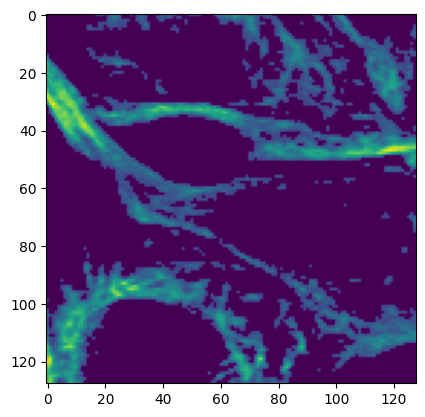

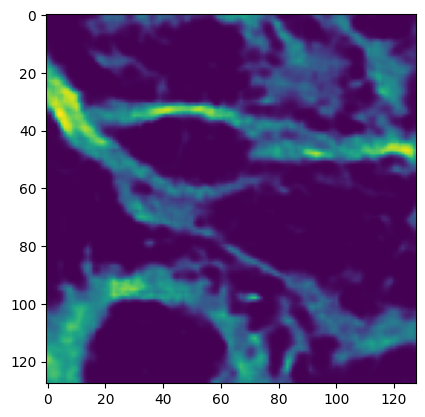

1


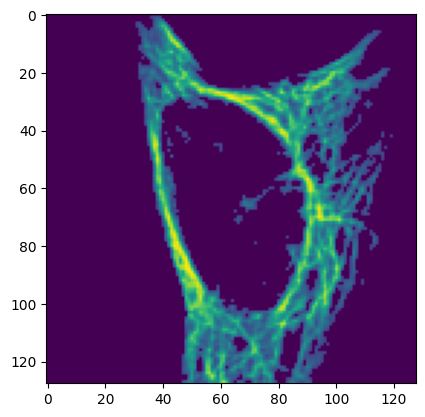

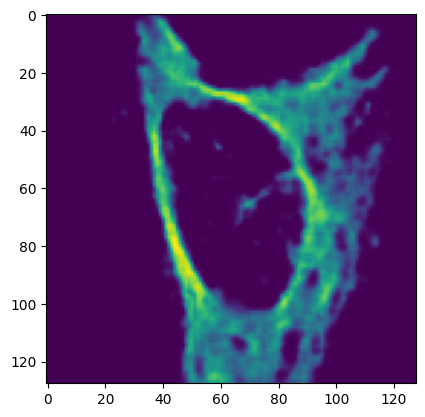

2


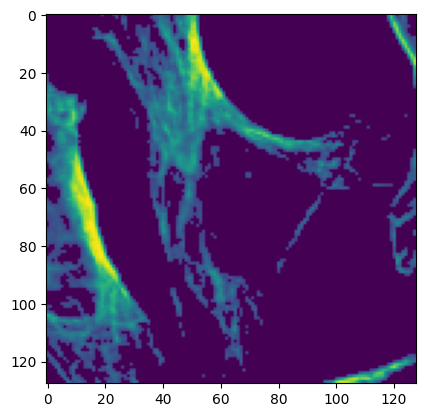

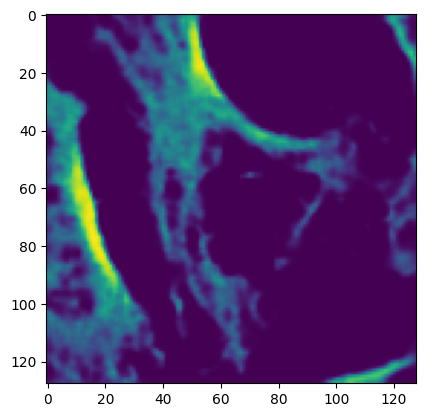

3


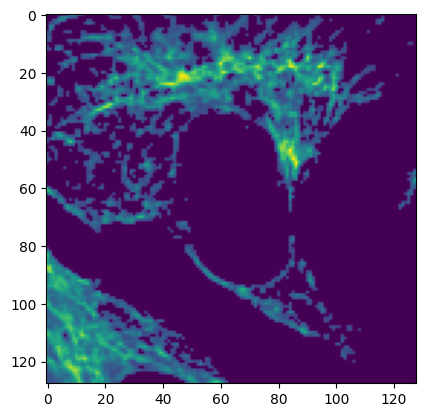

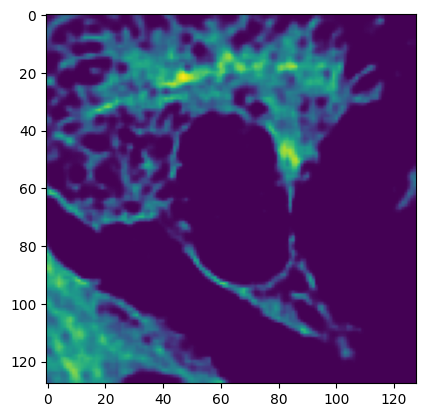

4


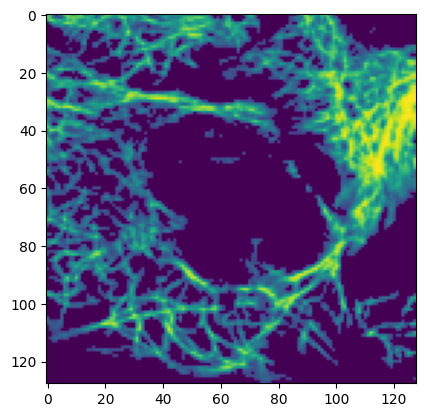

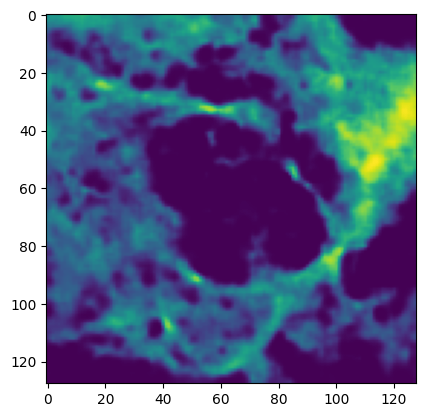

5


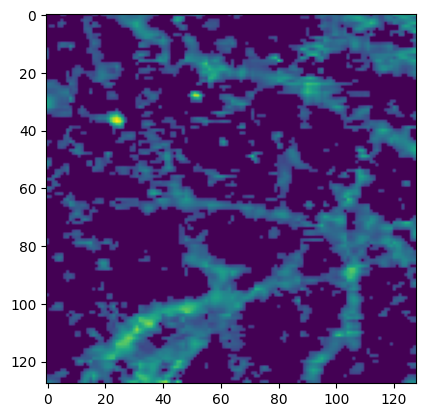

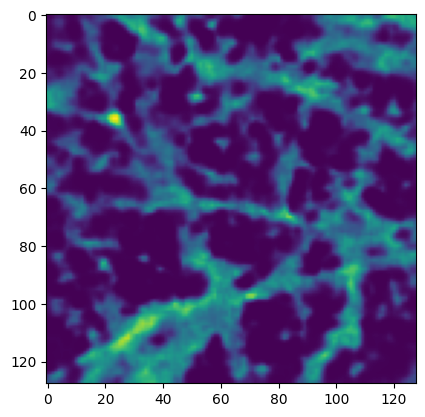

6


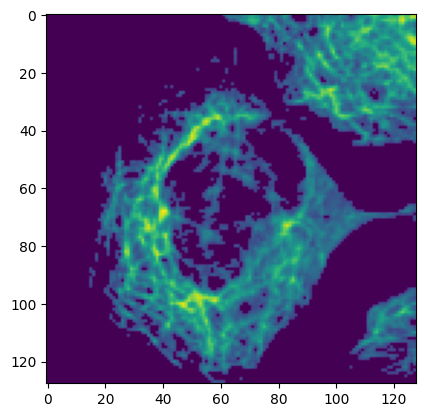

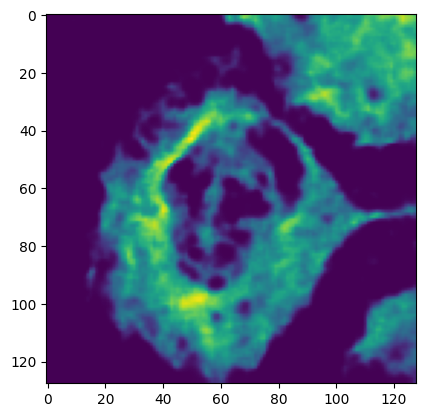

7


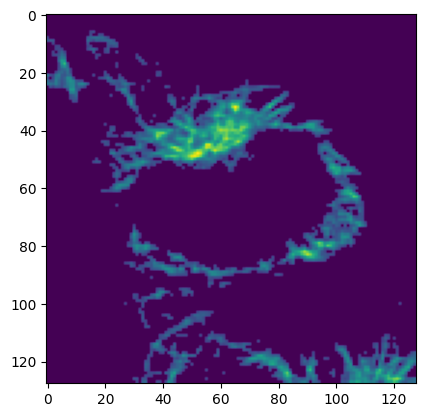

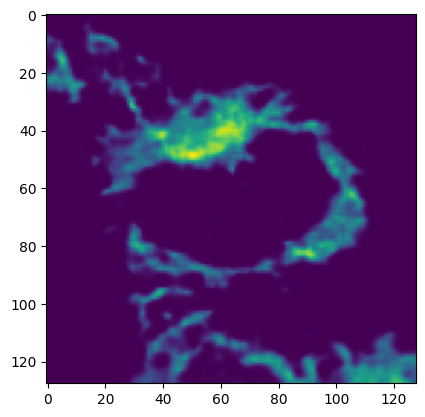

8


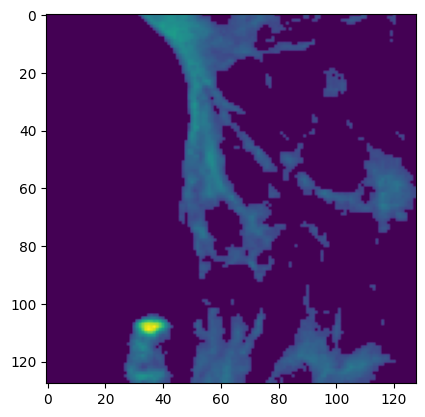

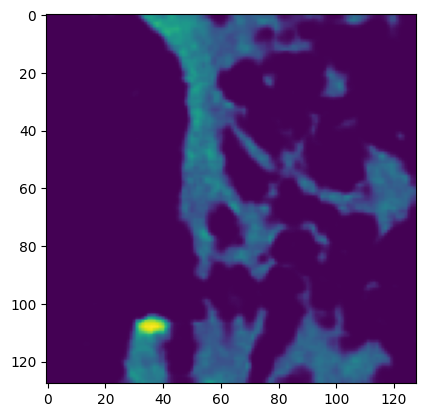

9


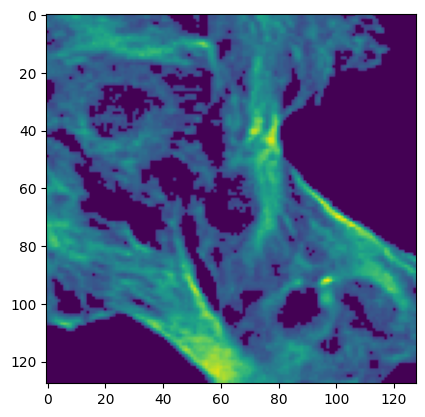

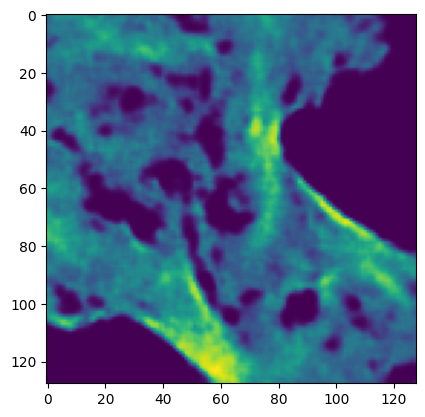

10


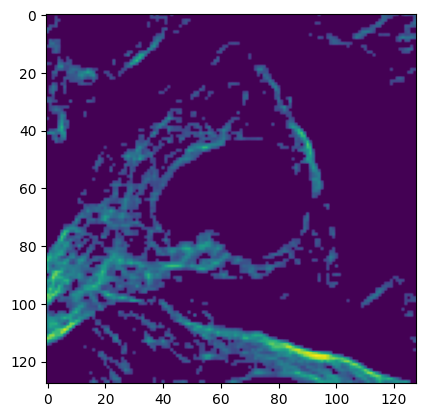

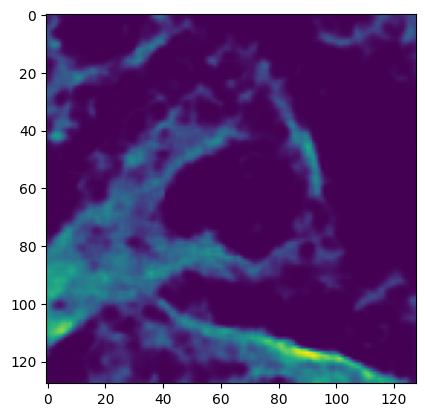

11


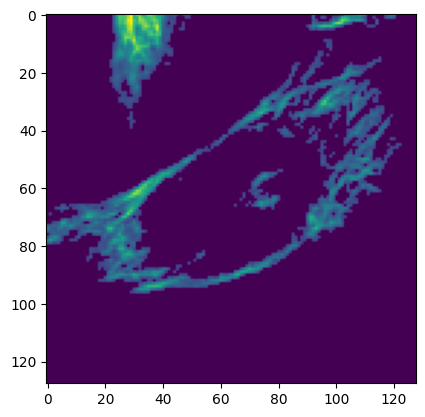

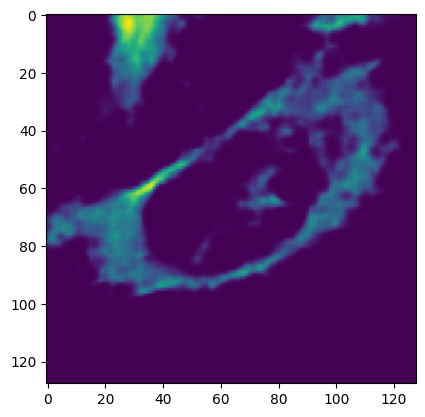

12


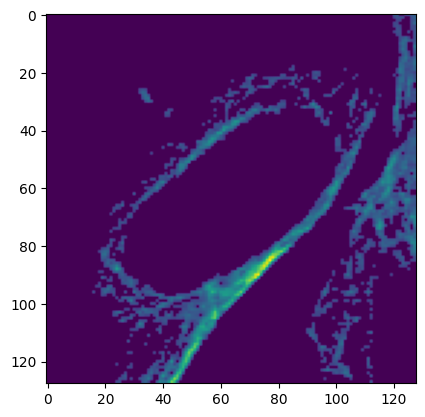

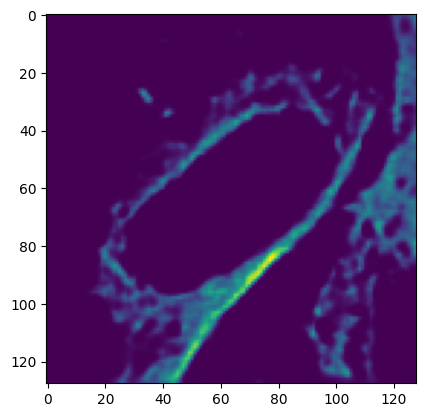

13


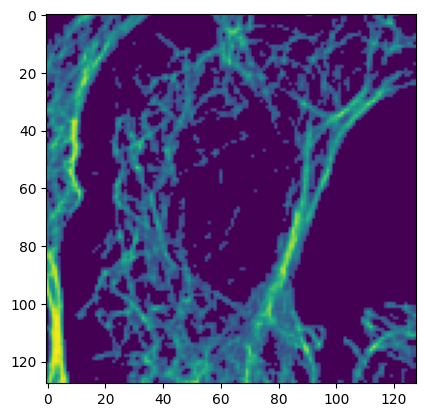

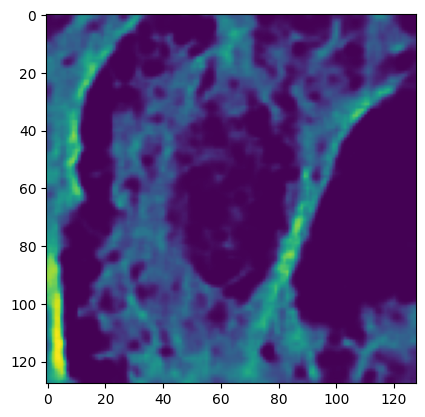

14


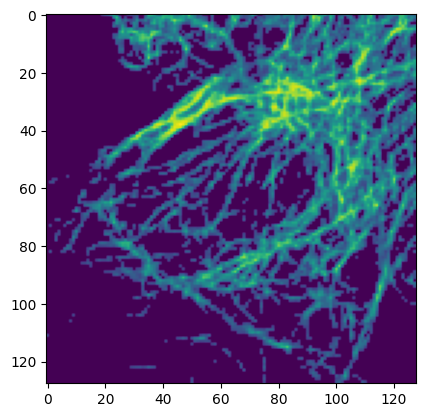

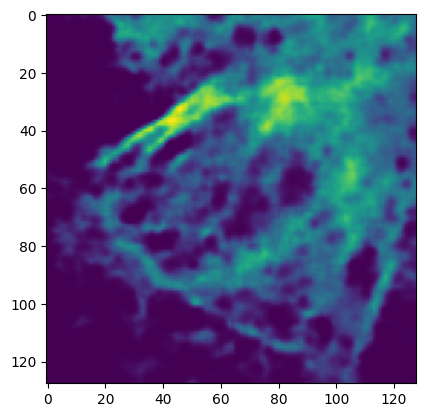

15


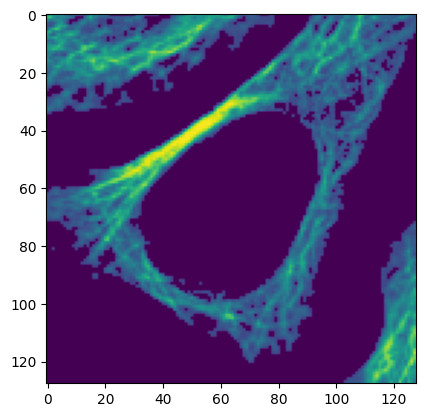

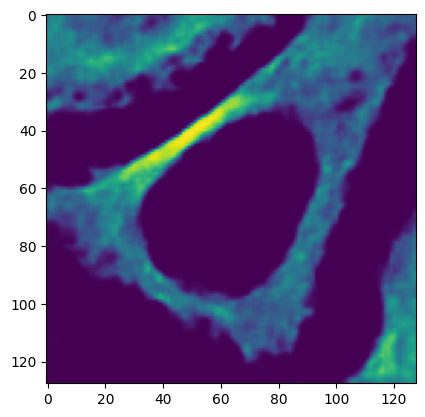

16


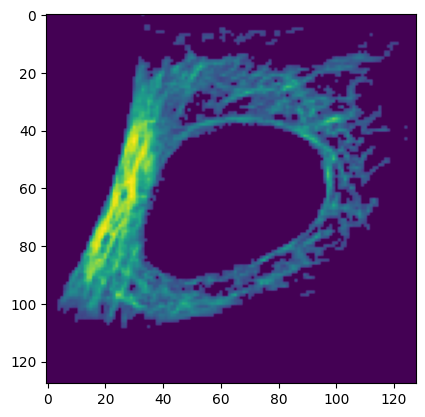

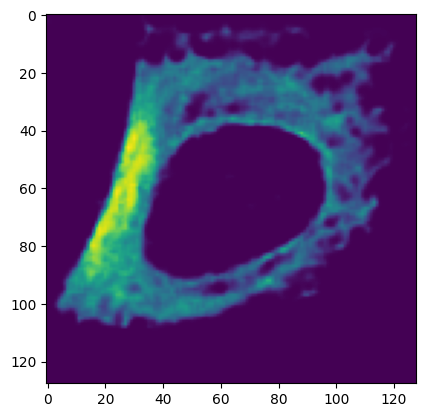

17


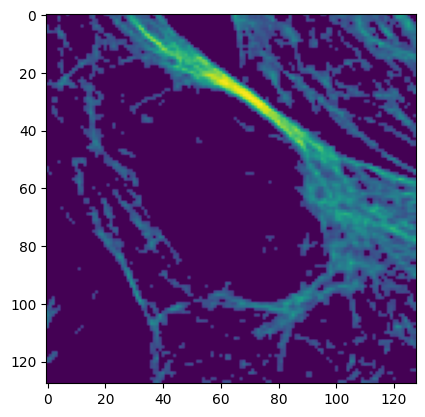

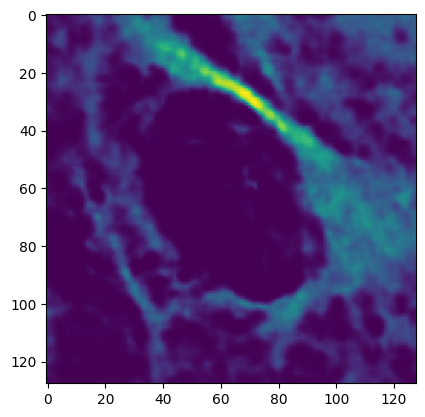

18


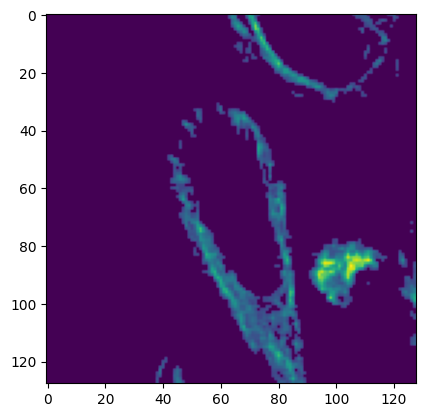

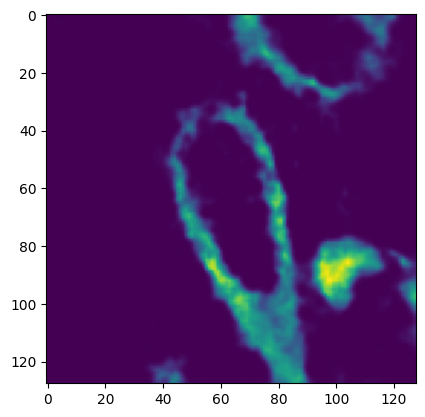

19


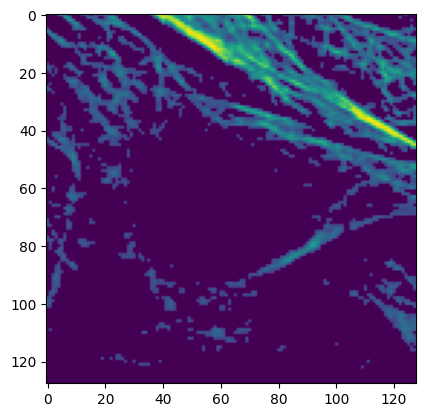

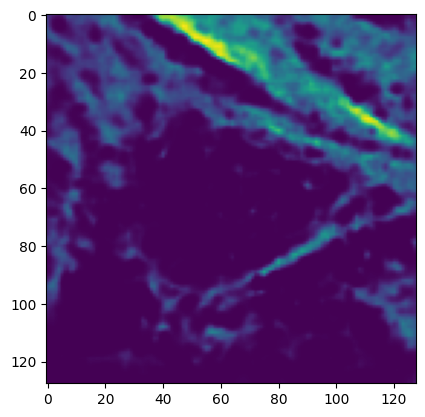

In [198]:
sigmoid=torch.nn.Sigmoid()
for i in range(20):
    print(i)
    plt.imshow(sigmoid(traintarget_protein[i][0]).cpu().detach().numpy())
    plt.show()
    plt.imshow(sigmoid(recon_protein[i][0]).cpu().detach().numpy())
    plt.show()

0


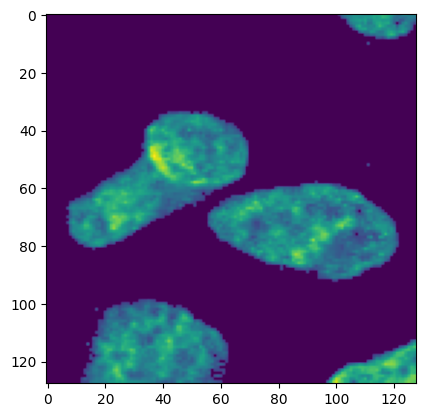

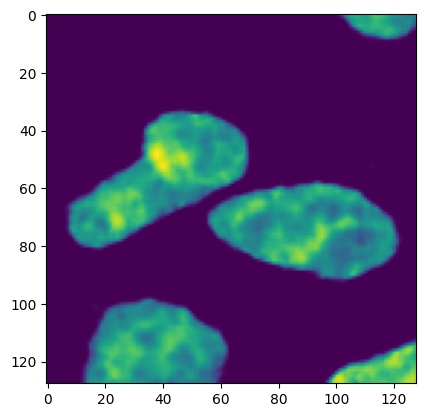

1


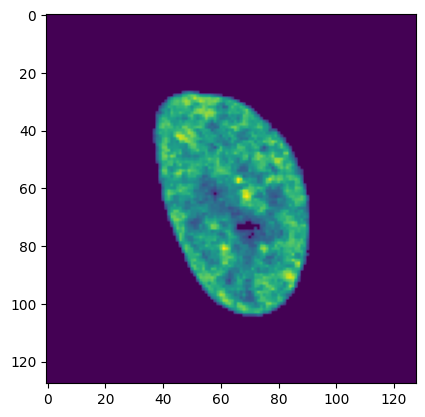

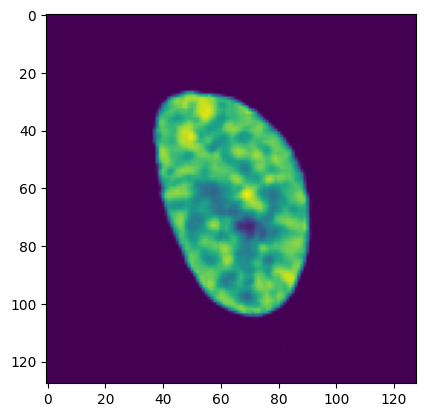

2


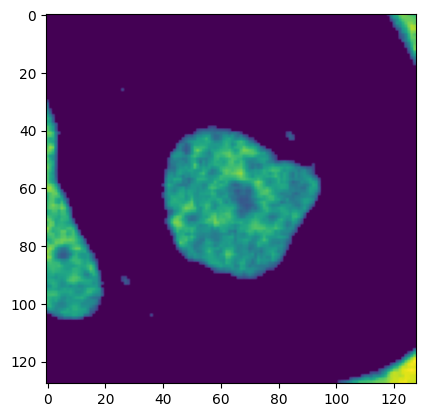

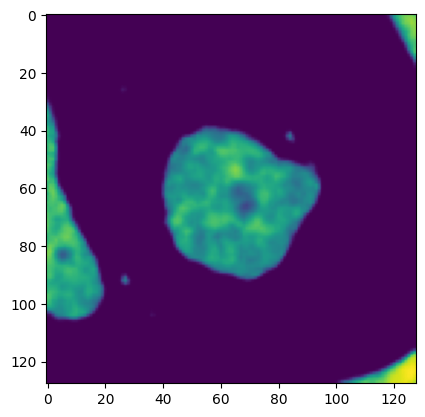

3


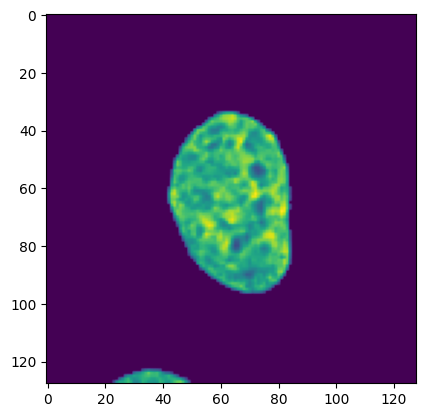

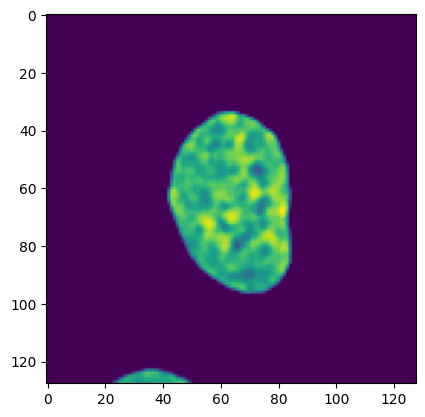

4


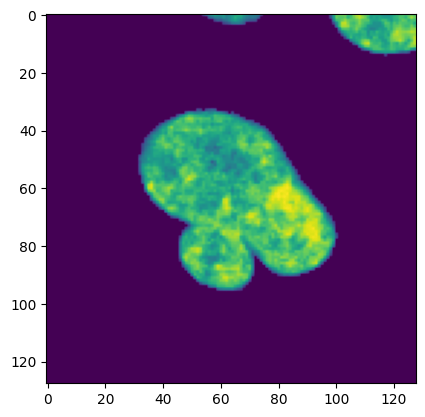

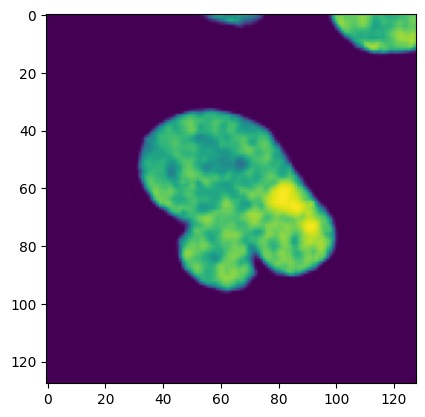

5


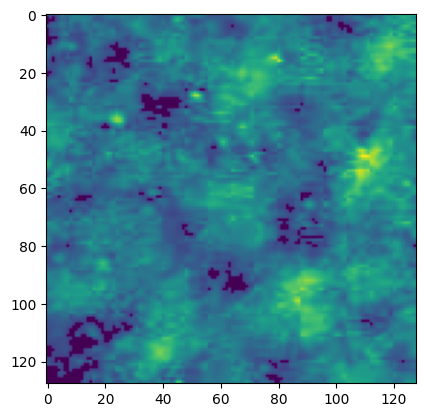

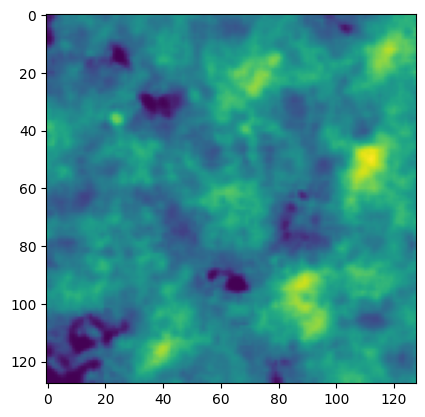

6


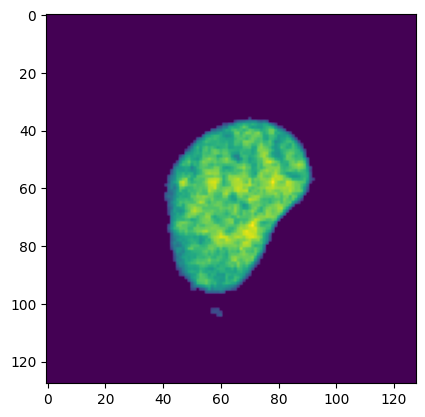

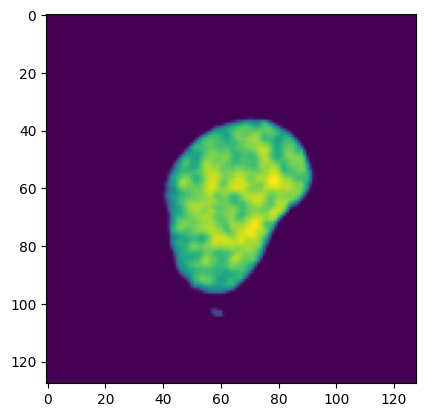

7


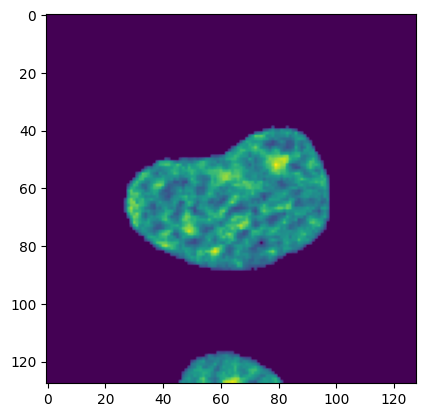

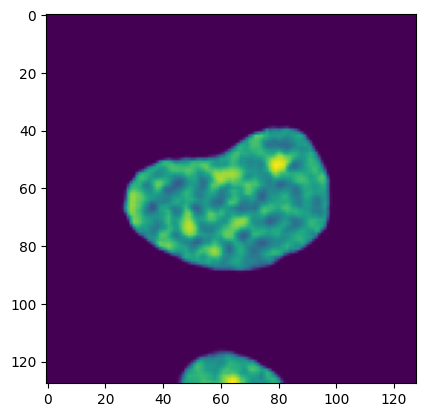

8


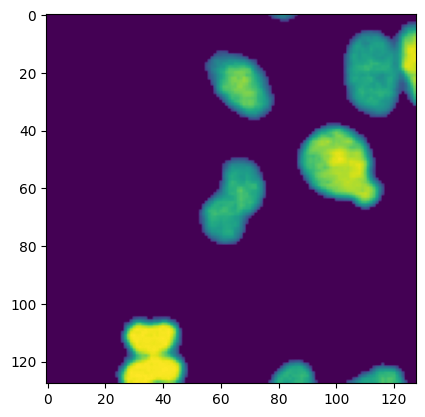

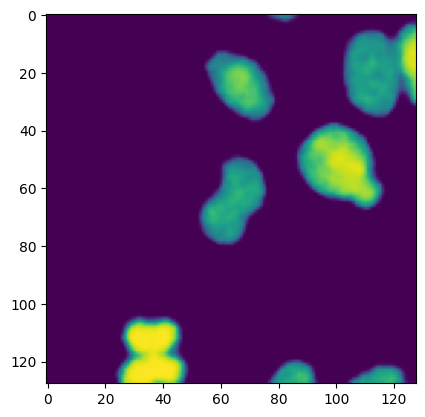

9


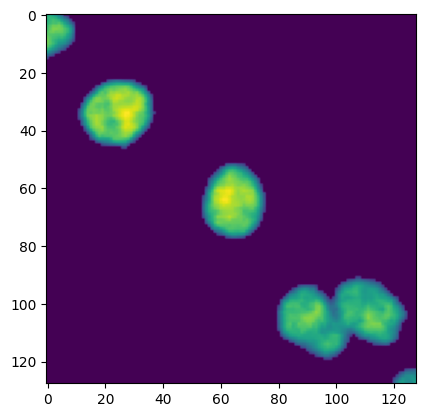

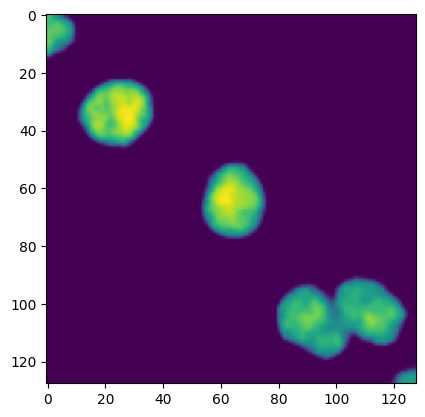

10


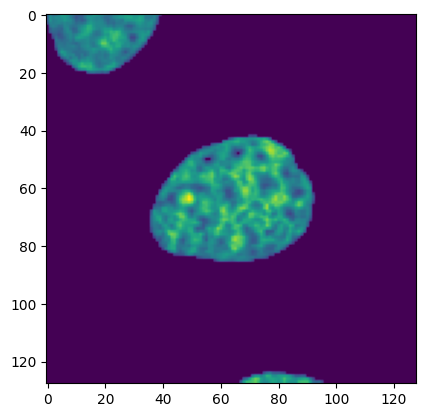

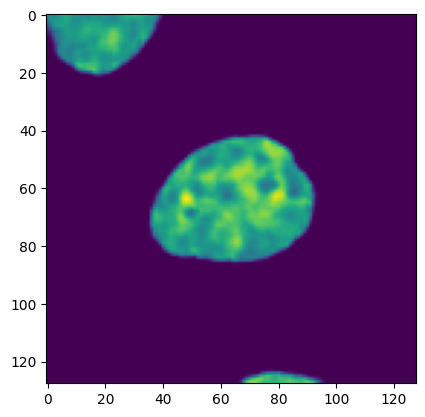

11


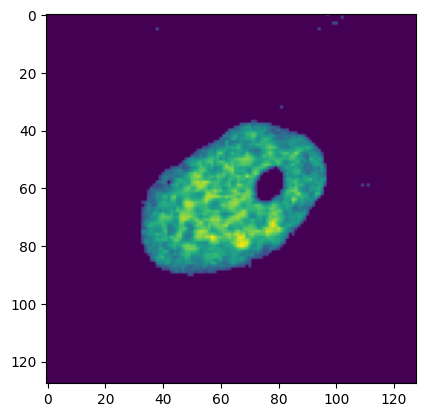

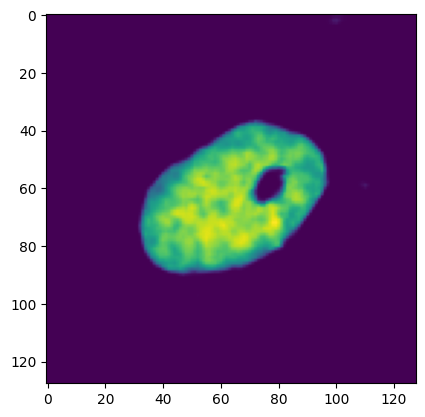

12


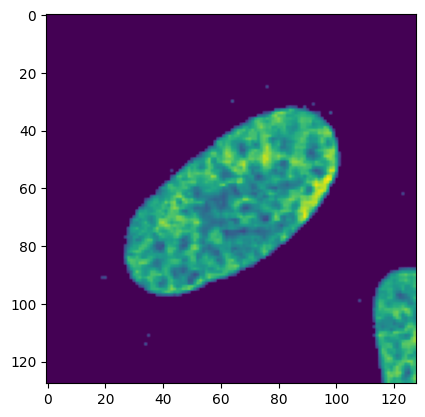

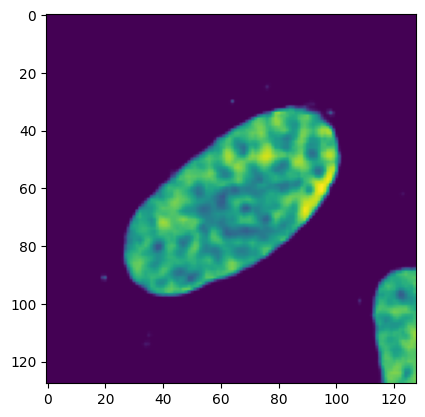

13


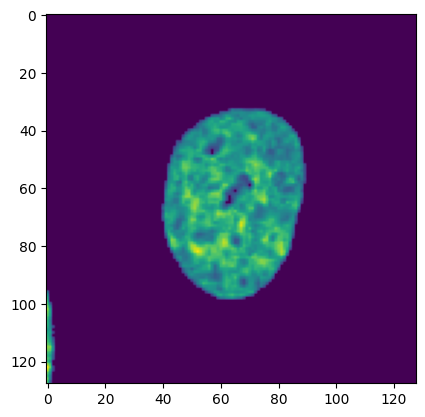

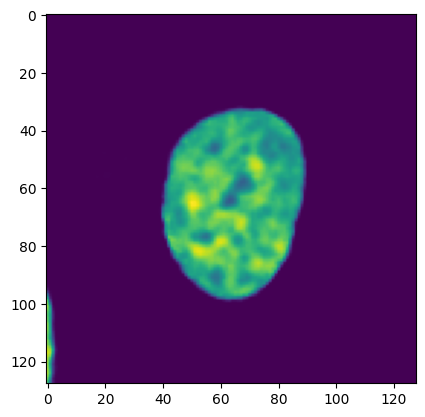

14


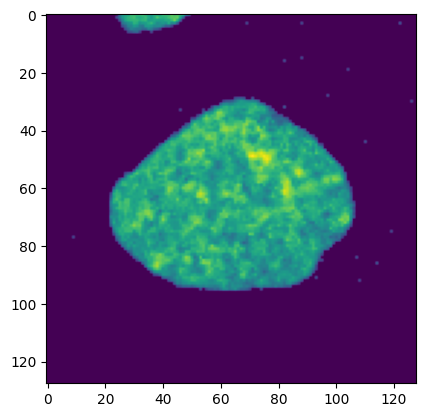

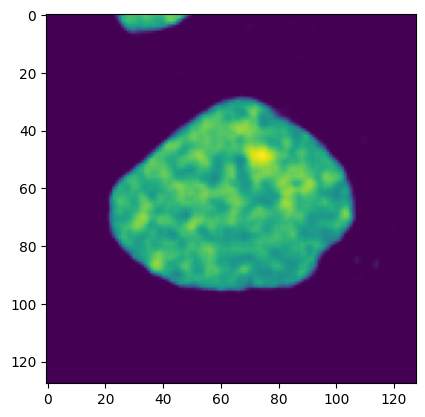

15


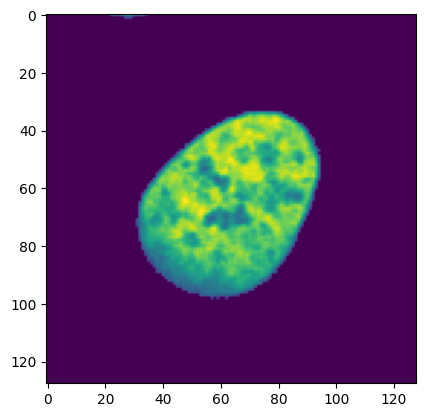

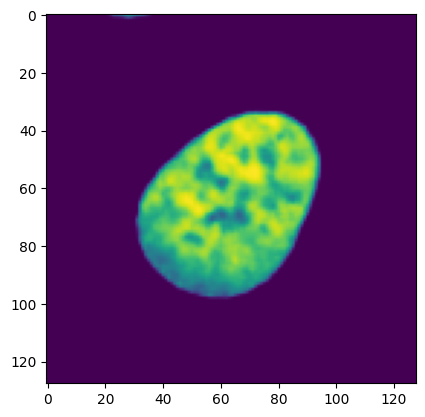

16


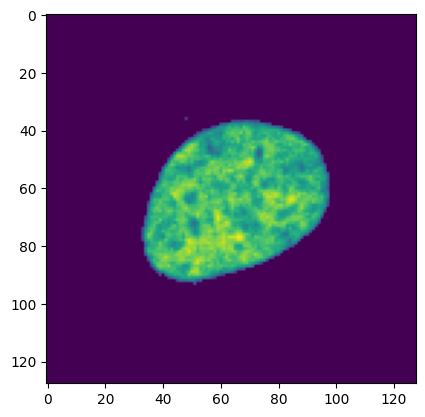

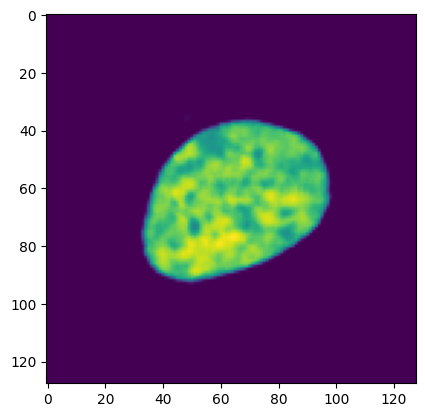

17


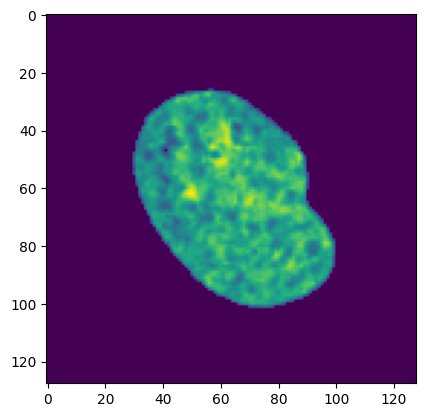

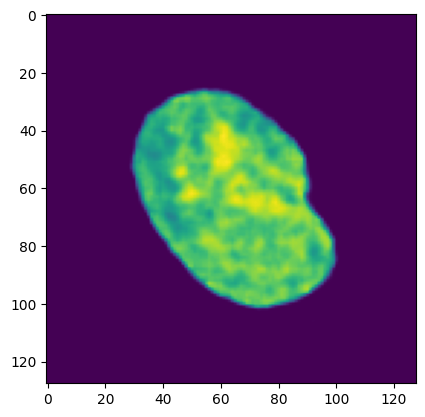

18


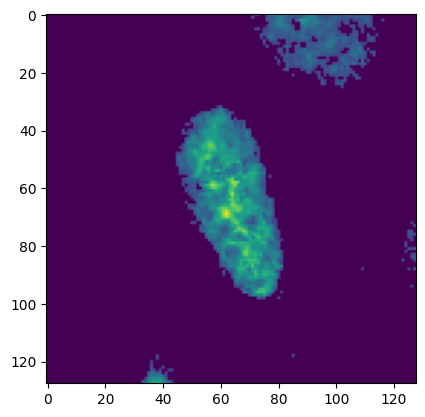

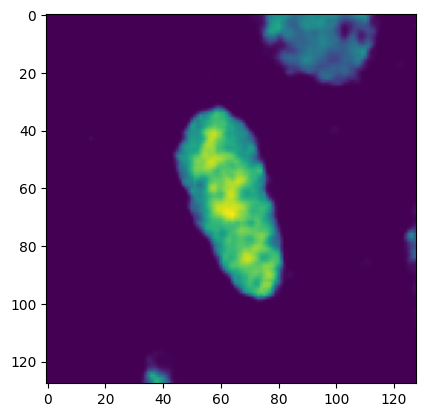

19


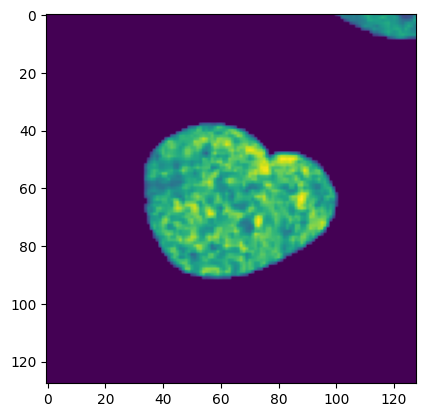

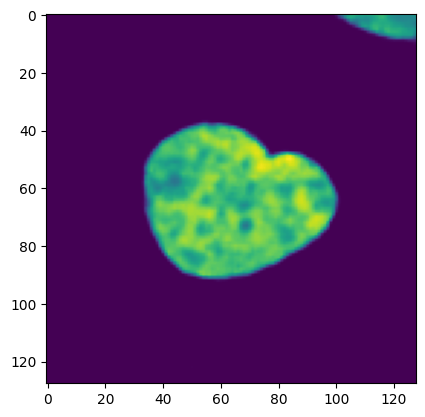

In [199]:
for i in range(20):
    print(i)
    plt.imshow(sigmoid(traintarget_dna[i][0]).cpu().detach().numpy())
    plt.show()
    plt.imshow(sigmoid(recon_dna[i][0]).cpu().detach().numpy())
    plt.show()

In [166]:
#all zeros for shared
with torch.no_grad():
    i=0
    trainIdx_i=trainIdx[i*batchsize:min((i+1)*batchsize,trainIdx.shape[0])]
    traintarget_protein=torch.tensor(imgsP_all[trainIdx_i]).cuda().float()
    trainIdx_i=torch.tensor(trainIdx_i)
    traintarget_dna=torch.tensor(imgsC_all[trainIdx_i]).cuda().float()
    trainInput_shared=torch.zeros_like(latent_shared_dec(trainIdx_i)).cuda().float()
    trainInput_dna=latent_dna_dec(trainIdx_i).cuda().float()
    trainInput_protein=latent_protein_dec(trainIdx_i).cuda().float()
    #         print(trainInput.shape)


    recon_dna= modelcnn_dna_dec(torch.cat((trainInput_shared,trainInput_dna),dim=1))
    recon_protein= modelcnn_protein_dec(torch.cat((trainInput_shared,trainInput_protein),dim=1))


0


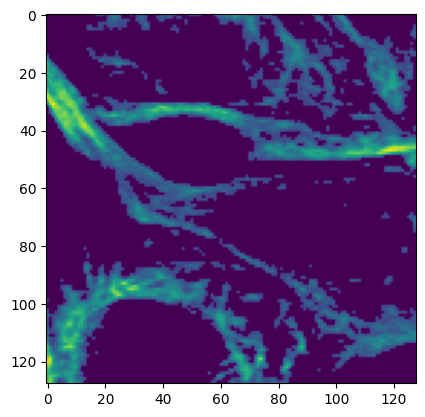

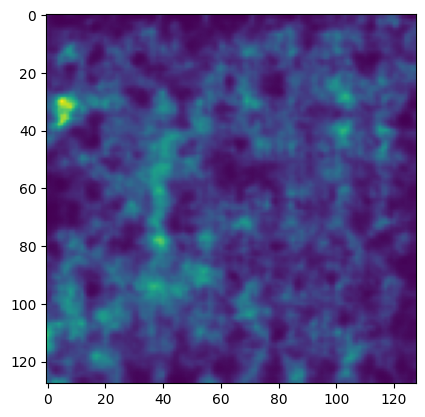

1


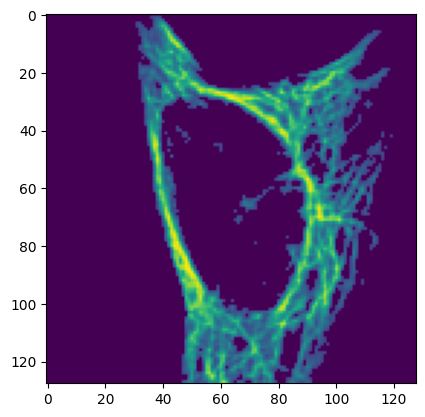

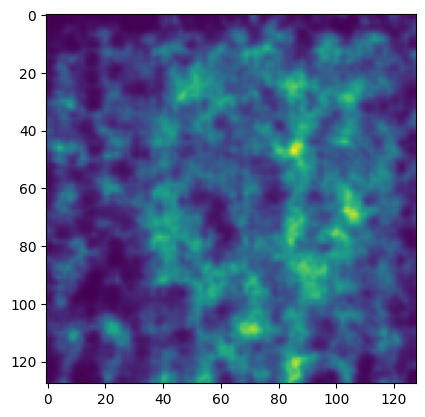

2


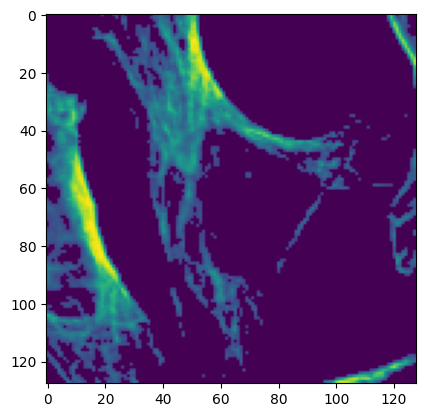

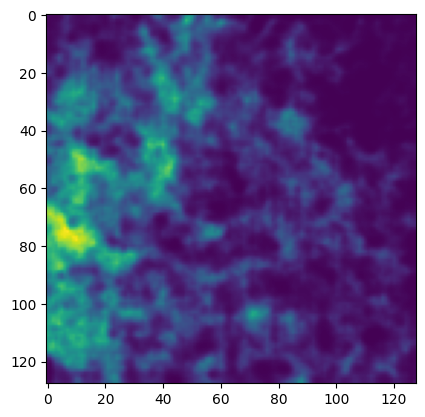

3


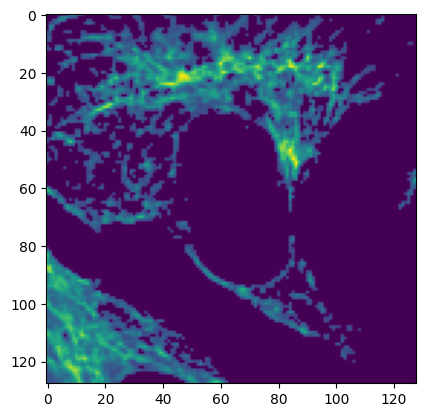

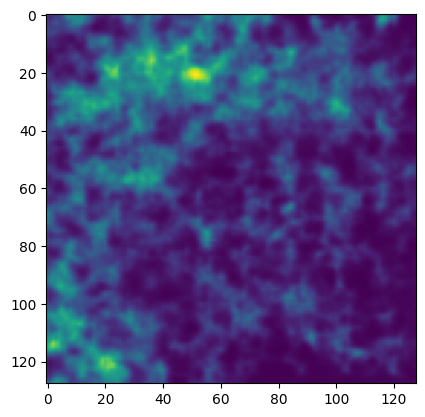

4


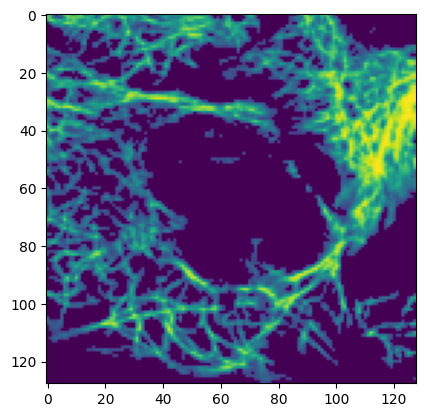

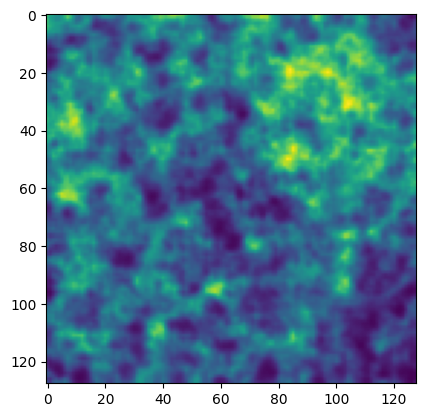

5


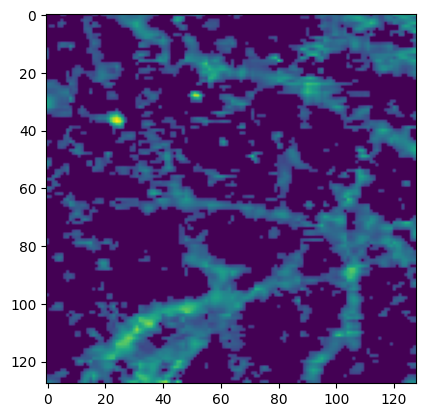

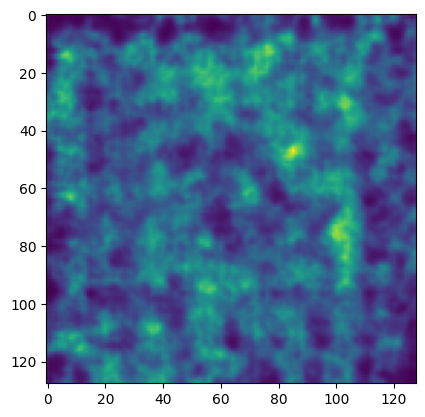

6


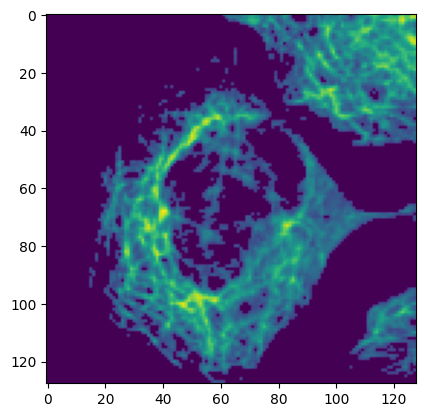

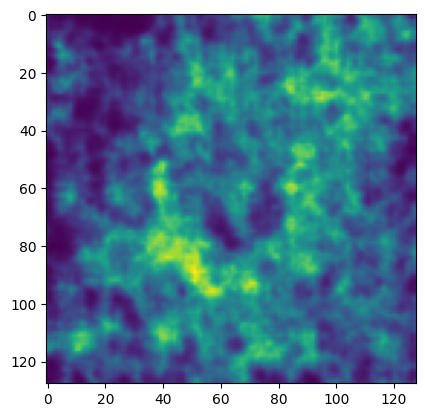

7


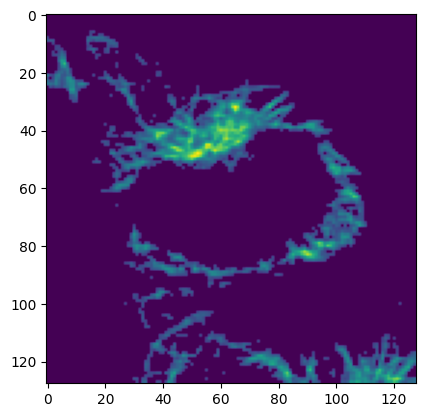

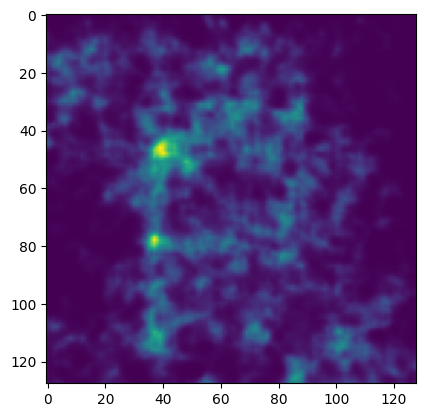

8


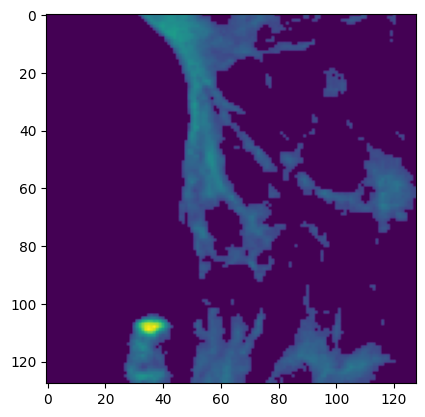

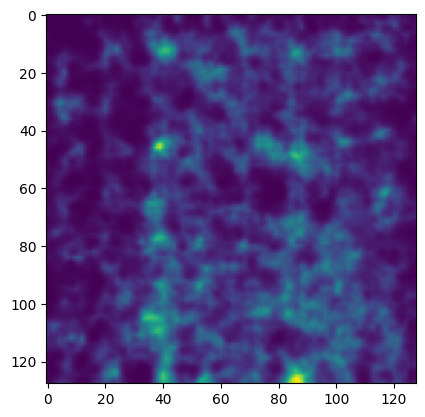

9


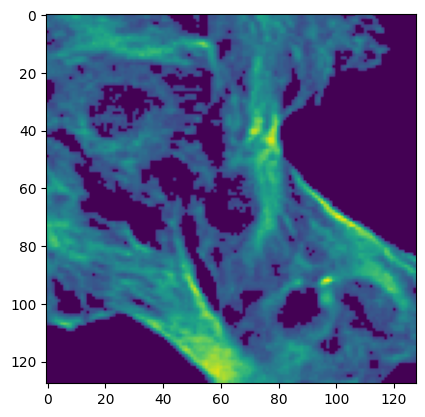

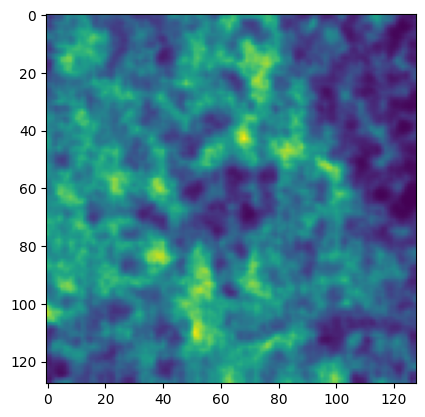

10


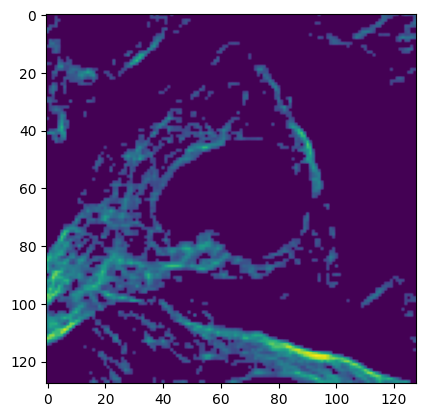

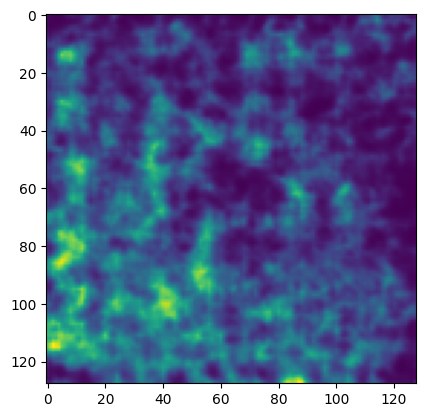

11


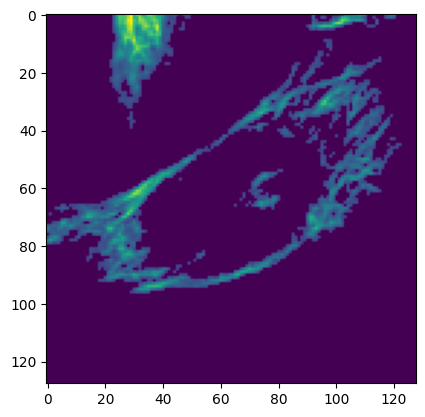

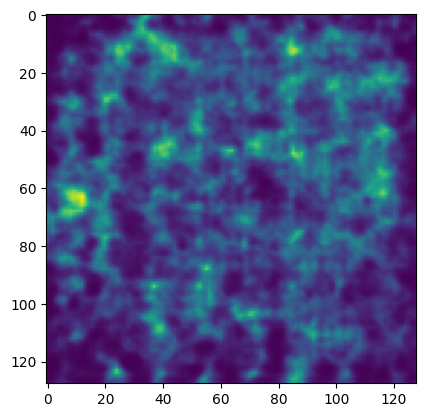

12


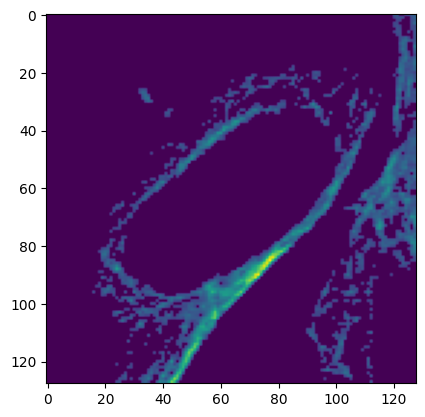

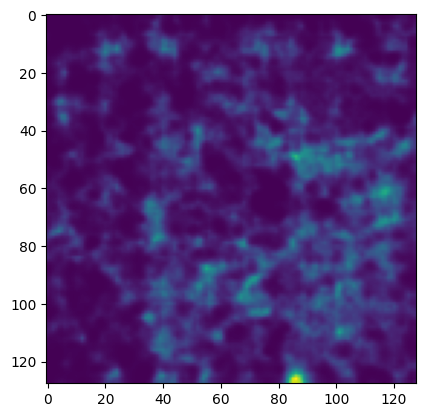

13


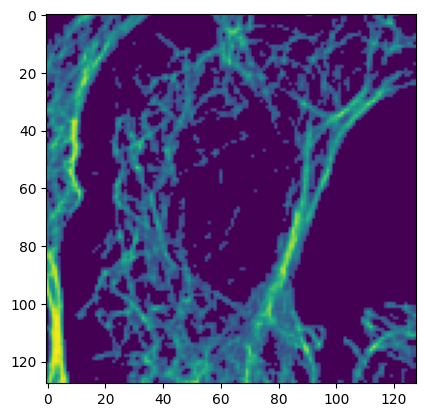

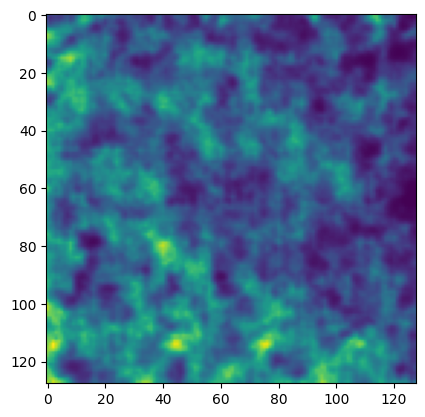

14


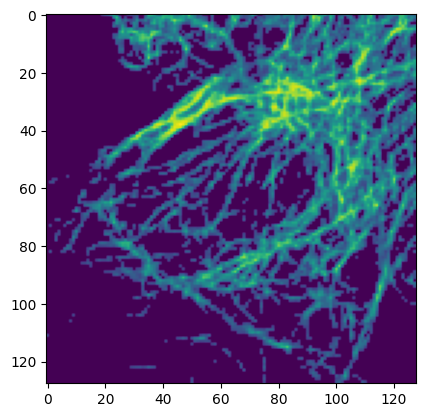

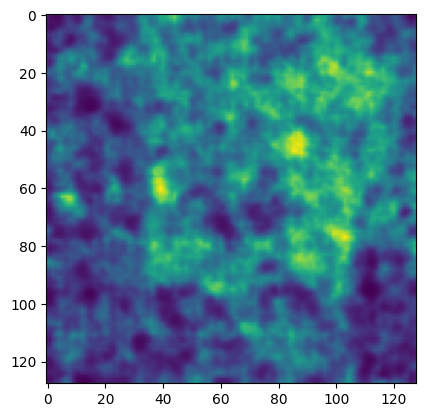

15


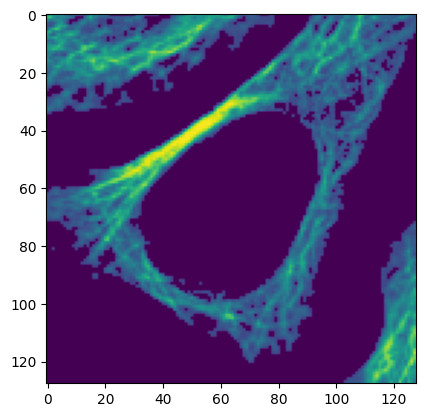

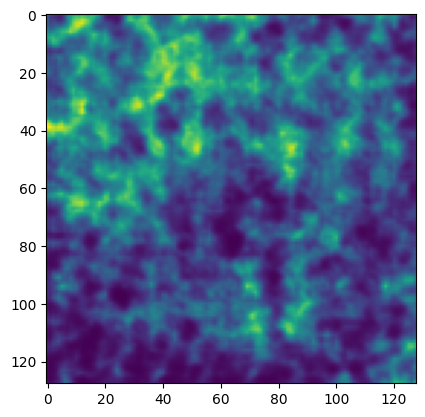

16


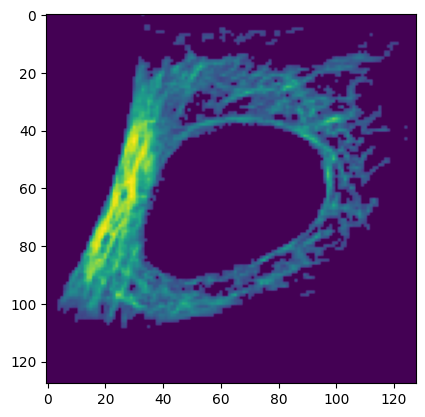

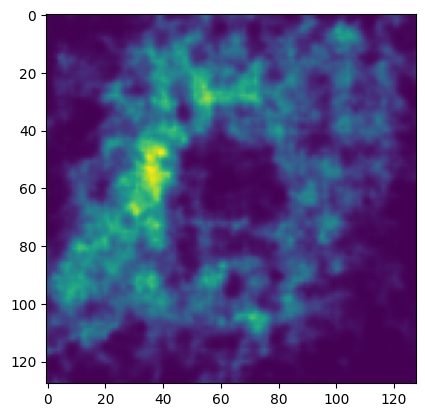

17


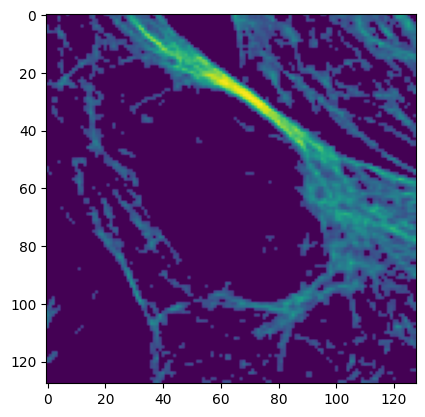

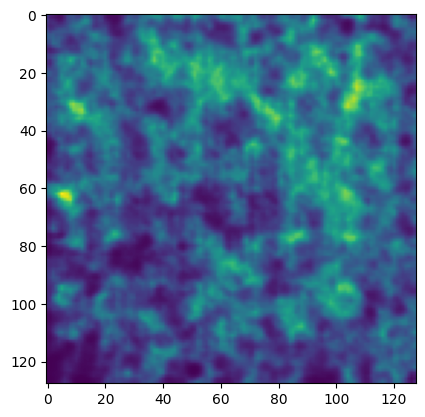

18


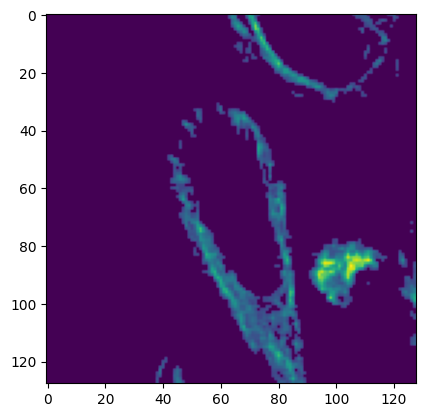

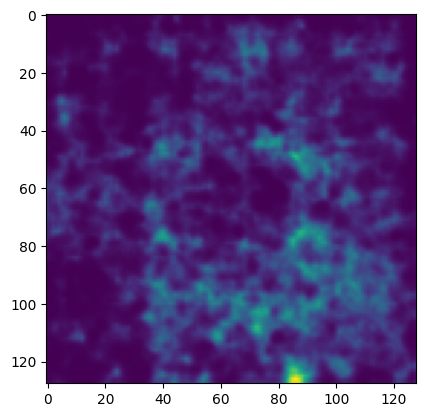

19


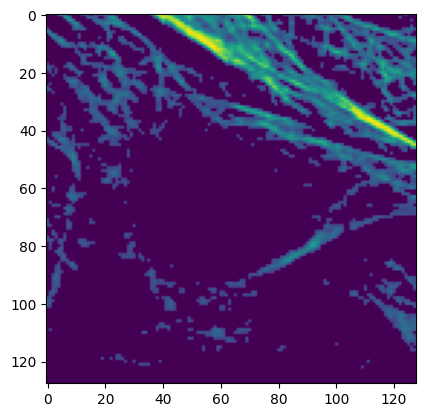

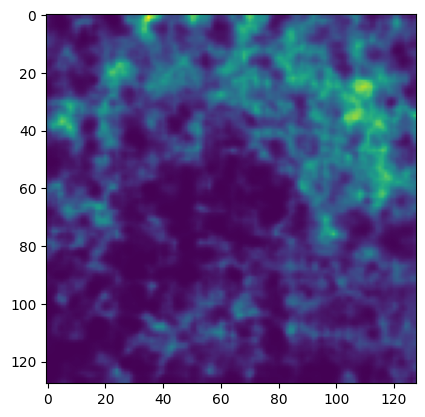

In [167]:
sigmoid=torch.nn.Sigmoid()
for i in range(20):
    print(i)
    plt.imshow(sigmoid(traintarget_protein[i][0]).cpu().detach().numpy())
    plt.show()
    plt.imshow(sigmoid(recon_protein[i][0]).cpu().detach().numpy())
    plt.show()

0


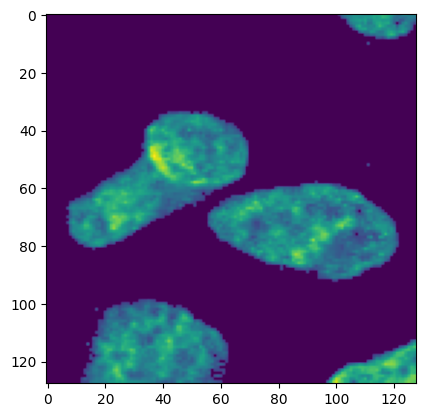

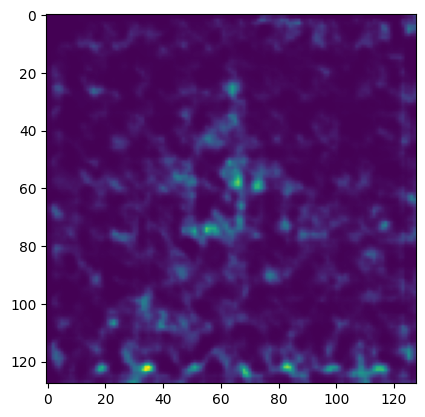

1


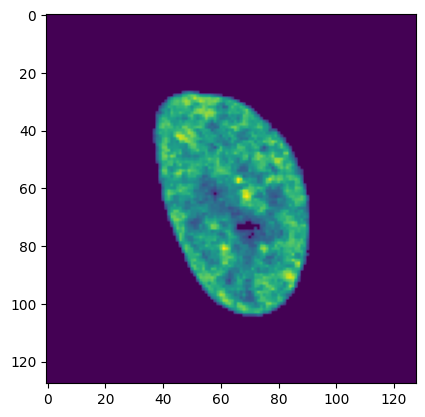

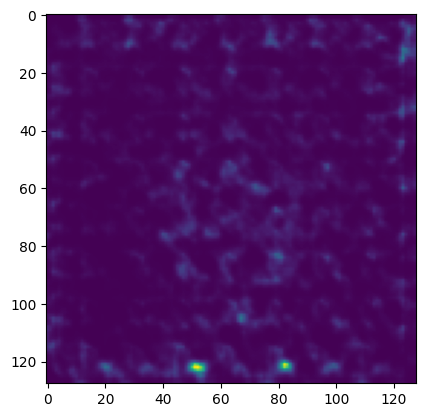

2


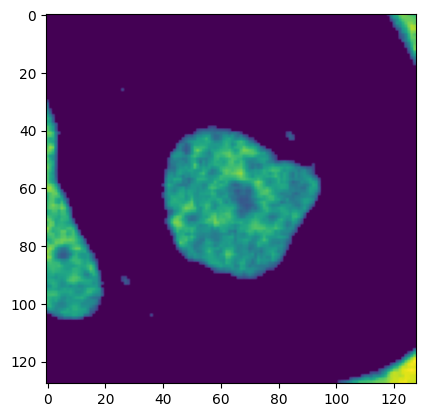

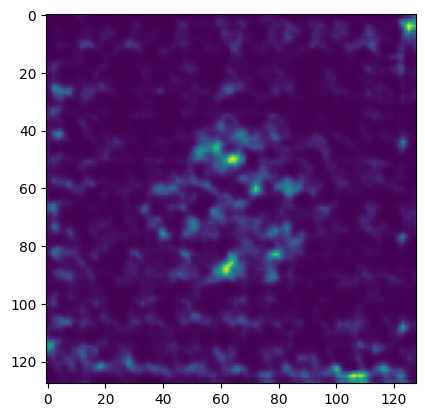

3


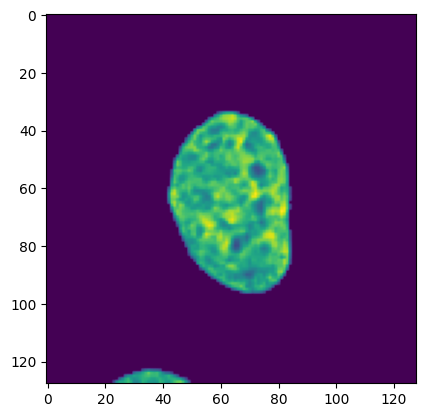

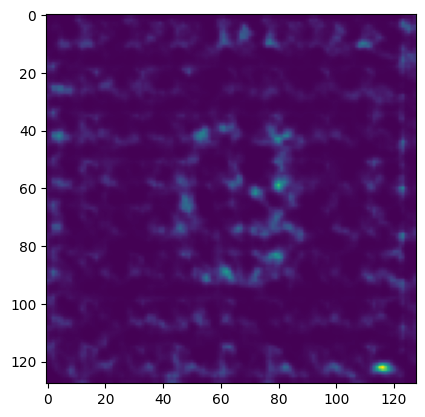

4


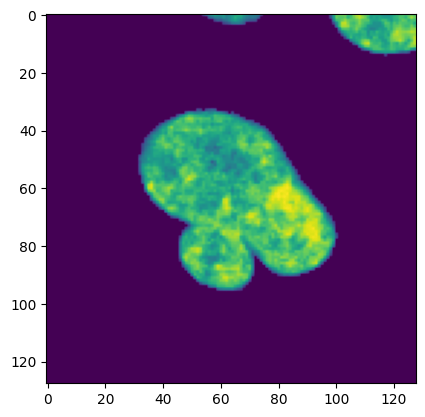

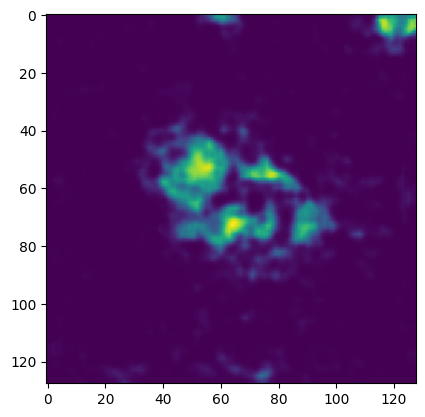

5


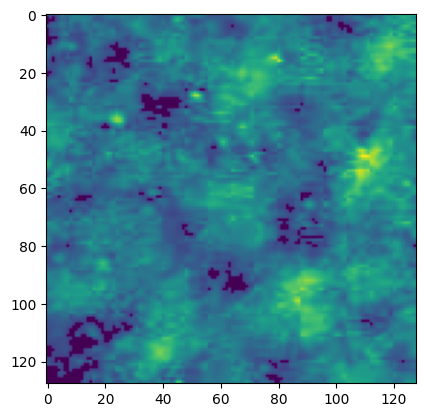

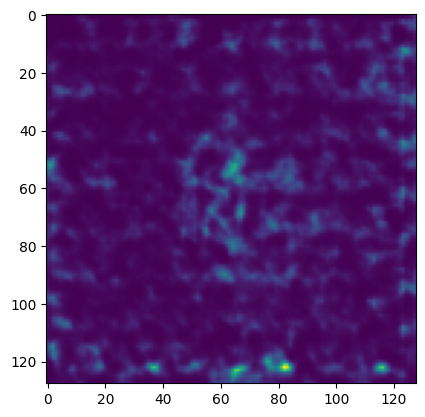

6


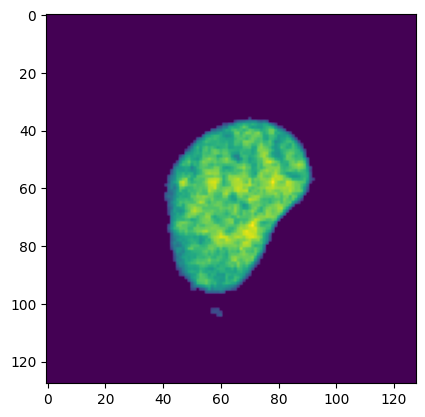

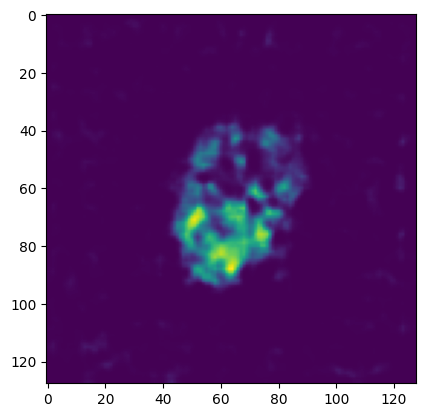

7


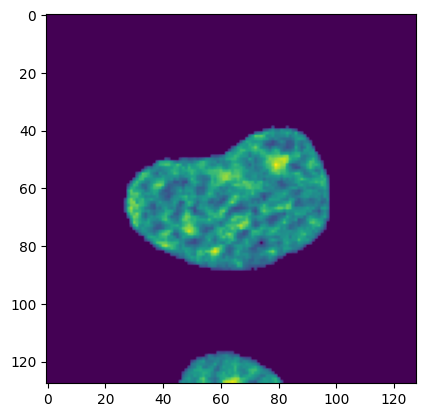

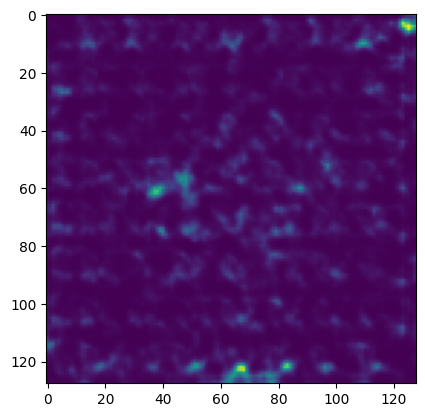

8


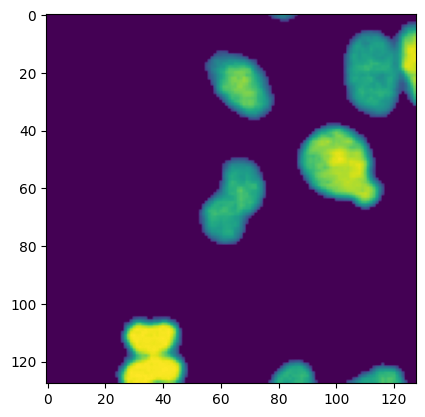

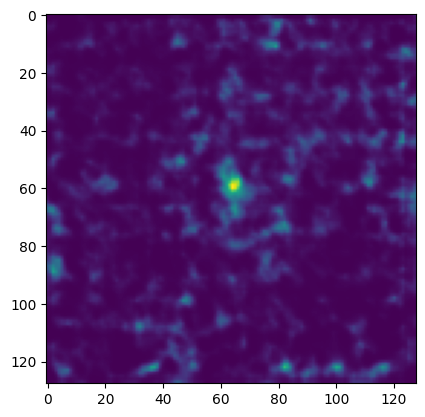

9


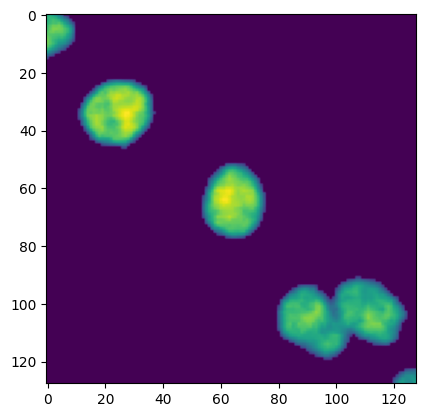

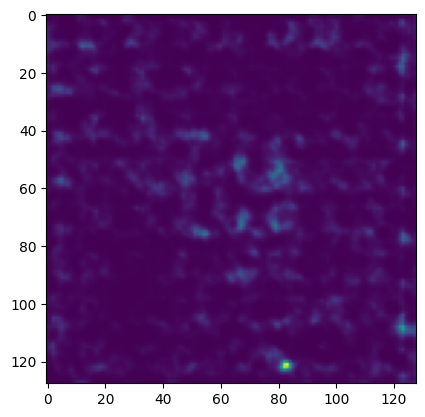

10


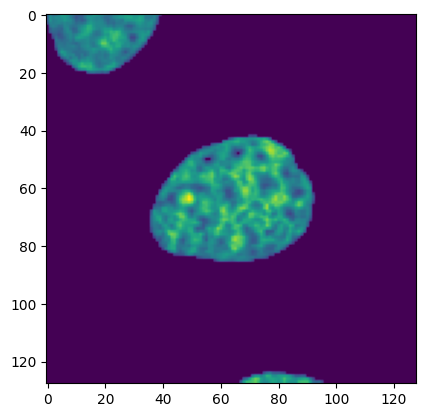

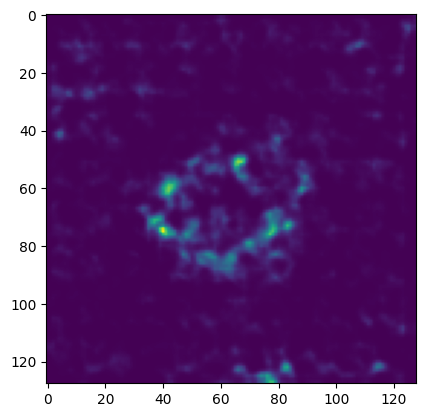

11


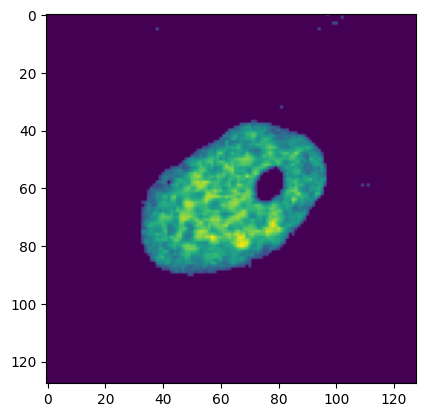

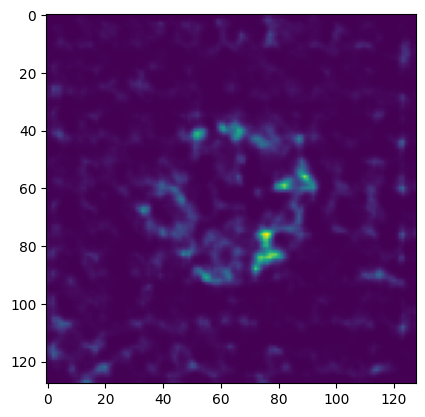

12


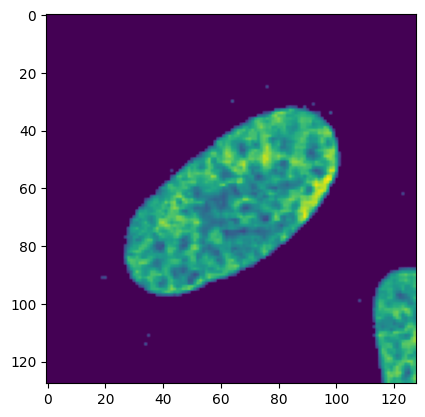

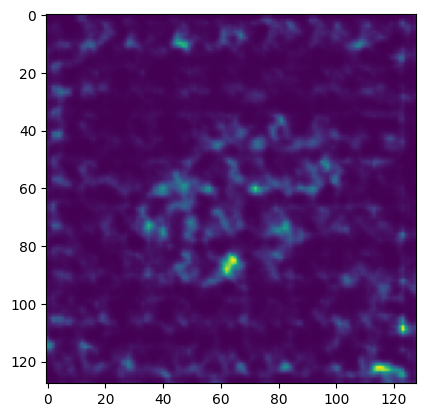

13


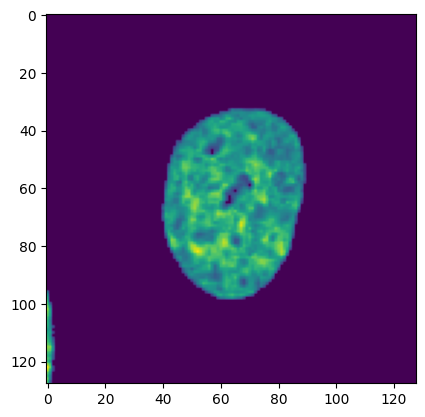

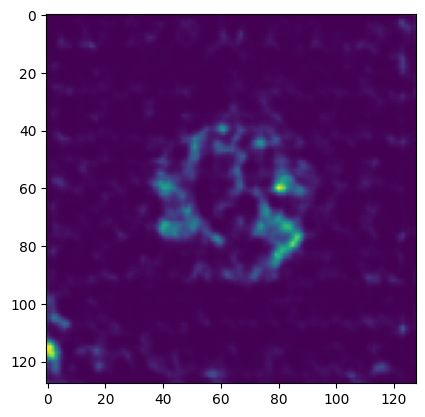

14


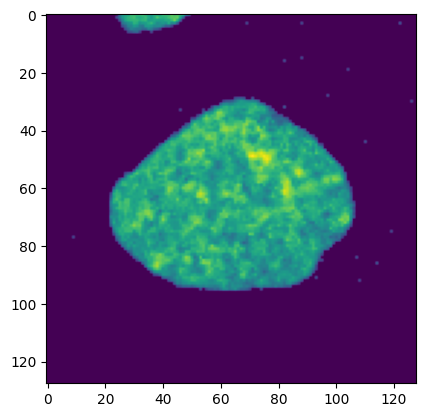

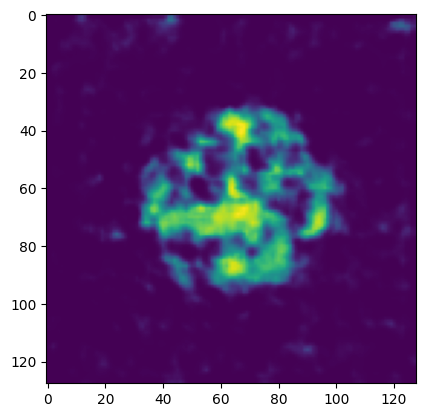

15


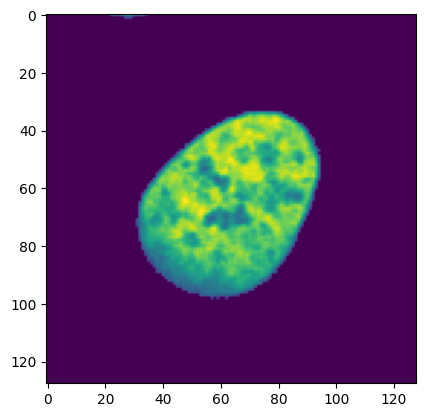

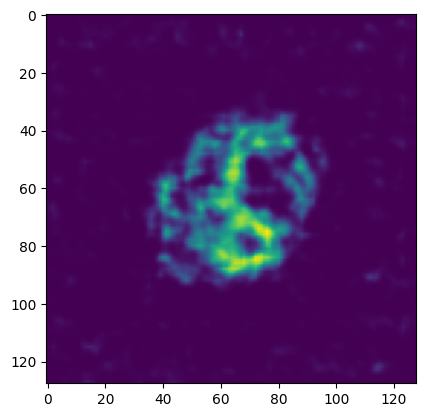

16


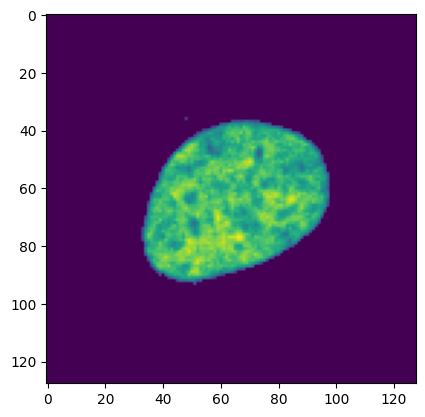

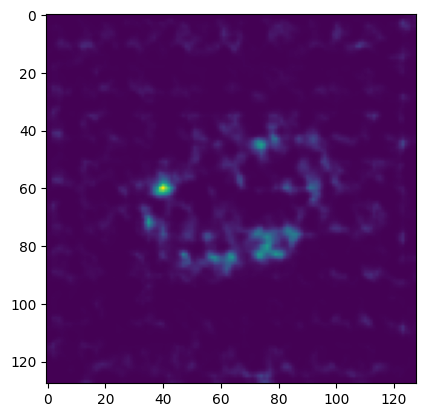

17


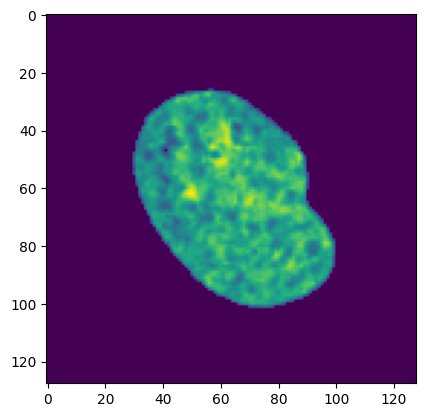

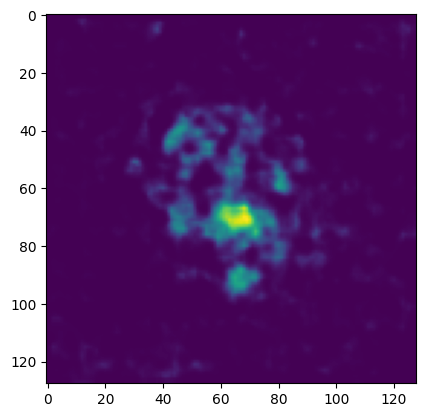

18


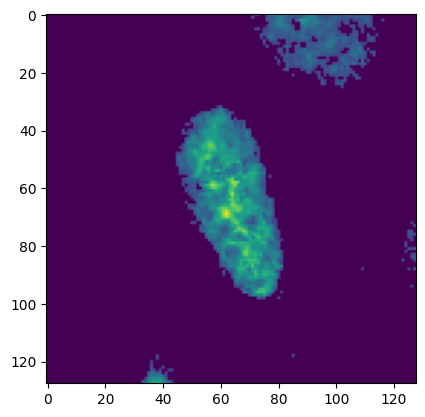

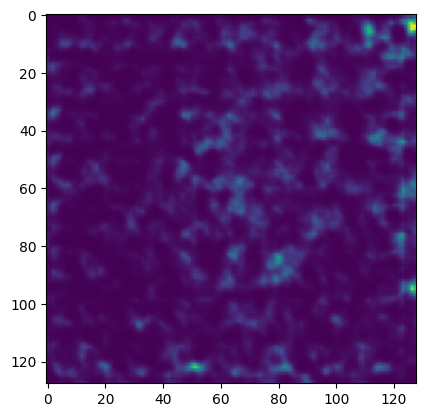

19


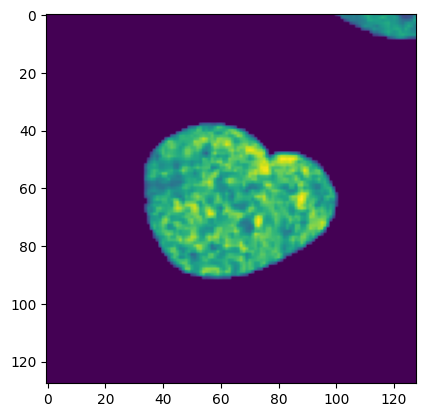

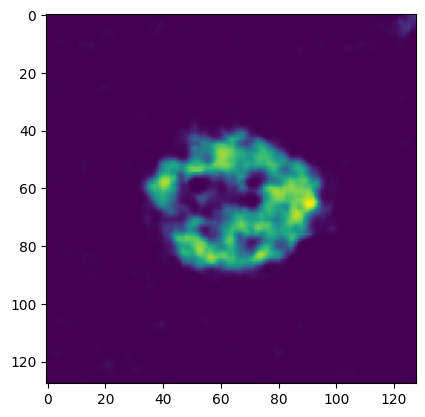

In [168]:
for i in range(20):
    print(i)
    plt.imshow(sigmoid(traintarget_dna[i][0]).cpu().detach().numpy())
    plt.show()
    plt.imshow(sigmoid(recon_dna[i][0]).cpu().detach().numpy())
    plt.show()

In [169]:
nsamples_all

37674

In [32]:
cellIDbyCellLine_pNamesFiltered_comb=np.concatenate((cellIDbyCellLine_pNamesFiltered,cellIDbyCellLine_new_pNamesFiltered))

In [173]:
cellIDbyCellLine_pNamesFiltered_comb

array(['BCL6', 'ATF7IP', 'CHAMP1', ..., 'ABI1', 'HNRNPC', 'HNRNPC'],
      dtype=object)

In [176]:
allImages.shape

(37674, 3, 128, 128)

In [178]:
from stardist.models import StarDist2D
from csbdeep.utils import normalize
from skimage.filters import gaussian
model_stardist = StarDist2D.from_pretrained('2D_versatile_fluo')
allNucProp=np.zeros(nsamples_all)
for i in range(cellIDbyCellLine_Filtered.size):
    if i%500==0:
        print(i)
    currProtImg=get_data(cellIDbyCellLine_Filtered[i],Retrieval_Data.TRUE_LABELS)[1]
    labeled_nuclei, linfo = model_stardist.predict_instances(gaussian(normalize(allImages[i,0])))
    nuc_mask=np.zeros((128,128))
    nuc_mask[labeled_nuclei>0]=1
    
    allNucProp[i]=np.sum(nuc_mask*currProtImg)/np.sum(currProtImg)
    
for i in range(cellIDbyCellLine_new_Filtered.size):
    if i%500==0:
        print(i)
    currProtImg=get_data_new(cellIDbyCellLine_new_Filtered[i],Retrieval_Data.TRUE_LABELS)[1]

    labeled_nuclei, linfo = model_stardist.predict_instances(gaussian(normalize(allImages[i+cellIDbyCellLine_Filtered.size,0])))
    nuc_mask=np.zeros((128,128))
    nuc_mask[labeled_nuclei>0]=1
    
    allNucProp[i+cellIDbyCellLine_Filtered.size]=np.sum(nuc_mask*currProtImg)/np.sum(currProtImg)


Found model '2D_versatile_fluo' for 'StarDist2D'.


2024-07-28 14:34:21.355993: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-28 14:34:21.361116: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.


Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
0
500
1000
1500
2000
2500
3000
3500
4000
4500
5000
5500
6000
6500
7000
7500
8000
8500
9000
9500
10000
10500
11000
11500
12000
12500
13000
13500
14000
14500
15000
15500
16000
16500
17000
17500
18000
18500
19000
19500
20000
20500
21000
21500
22000
22500
23000
23500
24000
24500
25000
25500
26000
26500
27000
27500
28000
28500
29000
29500
30000
30500
31000
31500
32000
32500
33000
33500
34000
34500
35000
35500
36000
0
500
1000
1500


In [179]:
with open(os.path.join('/mnt/d2/xinyi/c2p/hpa/plots/',modelname_train,'nucProp_u2os'), 'wb') as output:
    pickle.dump(allNucProp, output, pickle.HIGHEST_PROTOCOL)


In [33]:
with open(os.path.join('/mnt/d2/xinyi/c2p/hpa/plots/',modelname_train,'nucProp_u2os'), 'rb') as output:
    allNucProp=pickle.load(output)


In [34]:
allNucProp_byProtein=np.zeros(cellIDbyCellLine_pNamesUniqueFiltered.size)
for pidx in range(cellIDbyCellLine_pNamesUniqueFiltered.size):
    p=cellIDbyCellLine_pNamesUniqueFiltered[pidx]
    pidx_cell=cellIDbyCellLine_pNamesFiltered_comb==p
    allNucProp_byProtein[pidx]=np.std(allNucProp[pidx_cell])

In [35]:
allNucProp_stdRank=np.argsort(-allNucProp_byProtein)
allNucProp_stdRank

array([  6,  80,   7, 137, 129,   3, 125,   4,  95,  12,  93,   0,  91,
        47,  73,  11,  32, 119,   5, 128,  76, 108,  96,  65,  20,  37,
        14,  53,  69,  43,  90,  56,  27,  33,  26,  45,  61,  55, 112,
        16,  39, 136,  94,  21,  42,  85, 123,  31,  40,  68, 139,  92,
       105,  41,  22,  36,  19, 140,  84,  52, 103, 102,  78,  58,  83,
       131,  75,  29,  70,  66,  38, 130,  13,  74,  79, 126,  86,  10,
        15, 100,  54, 114, 135, 138,   1,  46, 111,   8,  34,  24,  18,
       132,  28,  81,  87,  49, 104, 127,  62, 120,  97,  98,  77,  72,
        82,  88,  67, 121,  60, 124, 133,  64, 107,  89,  44,  63,   9,
       101, 117,  48,  57,  35,  30,  59, 110,  25, 116, 134,  23,  99,
        17,  51, 122, 109, 118, 106,   2, 113,  50,  71, 115])

ABCB8


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


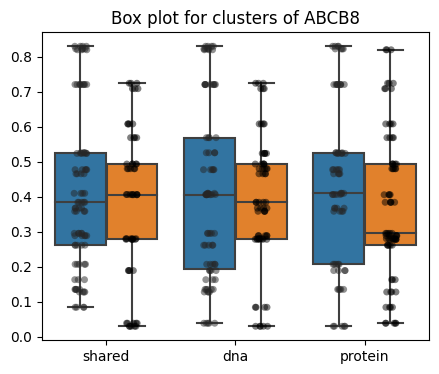

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.23743279925275107
Two-sided p-value for latent_dna_dec clusters: 0.46571015951950423
Two-sided p-value for latent_protein_dec clusters: 0.05307968785241541
CPSF6


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


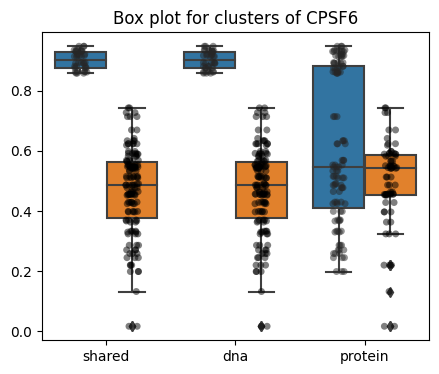

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 3.461493428429262e-45
Two-sided p-value for latent_dna_dec clusters: 3.461493428429262e-45
Two-sided p-value for latent_protein_dec clusters: 0.0005056270966195757
ABCC8


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


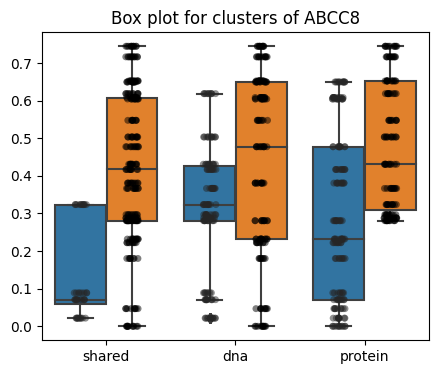

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 1.9583734226607824e-16
Two-sided p-value for latent_dna_dec clusters: 1.8124419204915131e-06
Two-sided p-value for latent_protein_dec clusters: 8.039094104466499e-14
FTSJ3


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


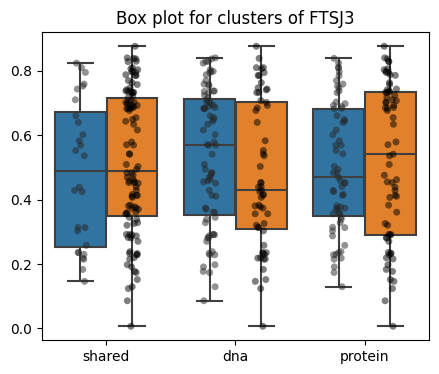

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.4586550872147912
Two-sided p-value for latent_dna_dec clusters: 0.13806549860595962
Two-sided p-value for latent_protein_dec clusters: 0.5563549366617349
FAM131A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


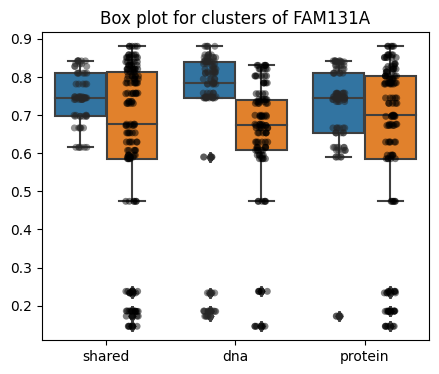

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 4.6345941712925614e-05
Two-sided p-value for latent_dna_dec clusters: 0.16064906227319406
Two-sided p-value for latent_protein_dec clusters: 0.005970904604868276
AASS


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


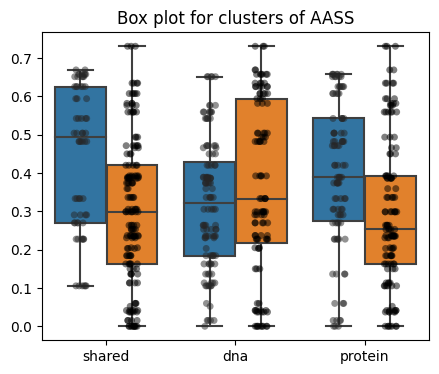

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 3.2309652453932215e-07
Two-sided p-value for latent_dna_dec clusters: 0.12998727978365343
Two-sided p-value for latent_protein_dec clusters: 0.00020478389776825727
ETFA


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


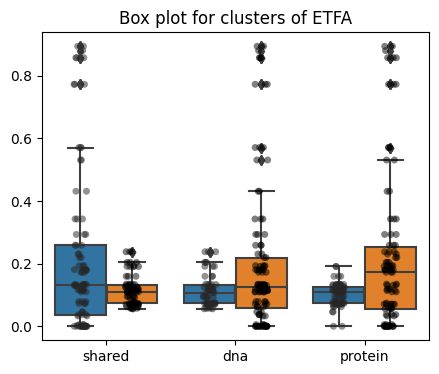

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.0007715813874391526
Two-sided p-value for latent_dna_dec clusters: 0.006607818654854947
Two-sided p-value for latent_protein_dec clusters: 9.636199313454878e-05
ABAT


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


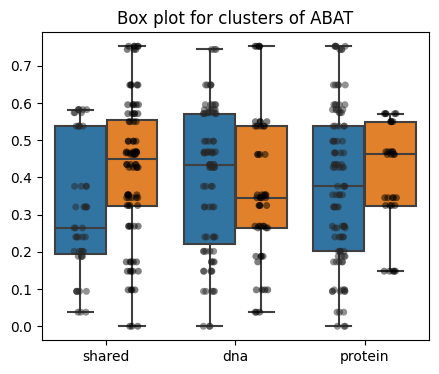

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.0018376158220071114
Two-sided p-value for latent_dna_dec clusters: 0.29844670146065655
Two-sided p-value for latent_protein_dec clusters: 0.467538190435566
DDX21


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


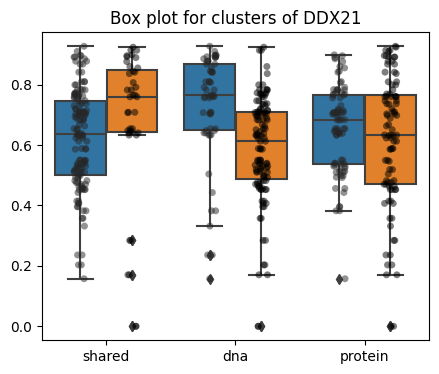

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.08418697764875324
Two-sided p-value for latent_dna_dec clusters: 2.2433482494611787e-06
Two-sided p-value for latent_protein_dec clusters: 0.15347663950083879
ADCY5


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


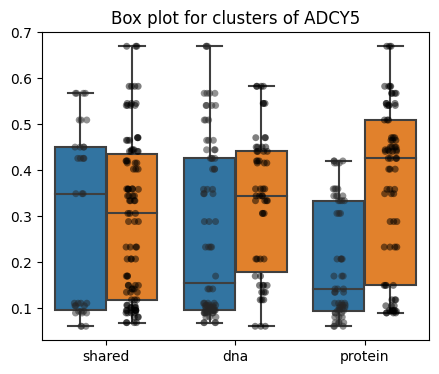

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.9118389368058499
Two-sided p-value for latent_dna_dec clusters: 0.02819169193229101
Two-sided p-value for latent_protein_dec clusters: 1.0976849781502158e-08
DDX1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


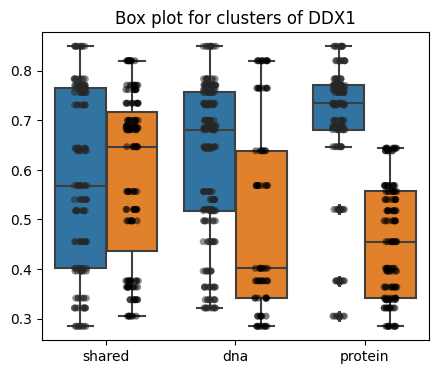

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.7019742129597186
Two-sided p-value for latent_dna_dec clusters: 1.7519169855231102e-06
Two-sided p-value for latent_protein_dec clusters: 2.1042482832173853e-40
A1CF


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


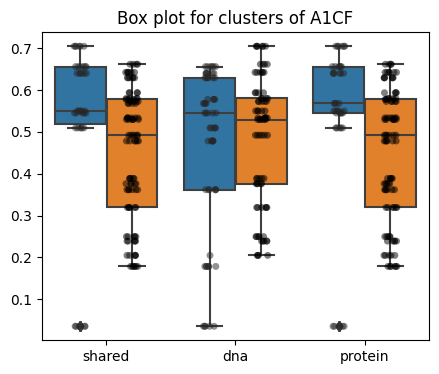

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.014428449121959999
Two-sided p-value for latent_dna_dec clusters: 0.6058286354092168
Two-sided p-value for latent_protein_dec clusters: 0.005297270391853471
DDB1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


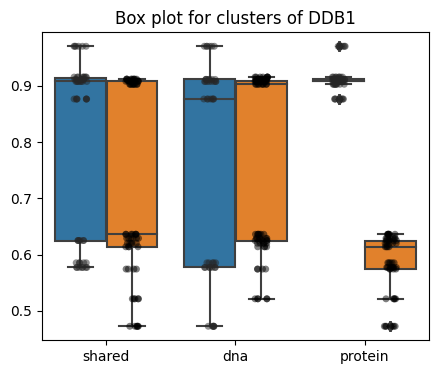

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.009987836708785985
Two-sided p-value for latent_dna_dec clusters: 0.8059055479645141
Two-sided p-value for latent_protein_dec clusters: 9.362914818586676e-79
C8orf59


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


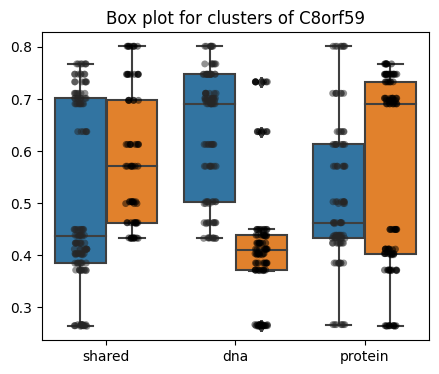

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.00032445766207591693
Two-sided p-value for latent_dna_dec clusters: 5.980251716895538e-28
Two-sided p-value for latent_protein_dec clusters: 0.05360926204677917
CIZ1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


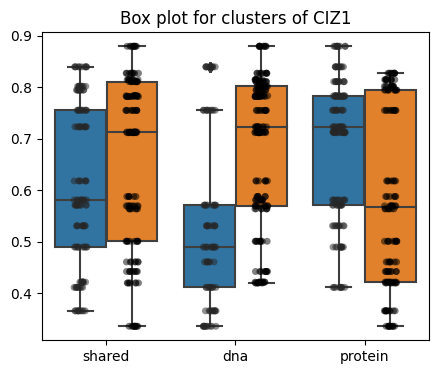

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.024456646335724752
Two-sided p-value for latent_dna_dec clusters: 4.911047074245348e-13
Two-sided p-value for latent_protein_dec clusters: 4.594241155575768e-08
ADAR


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


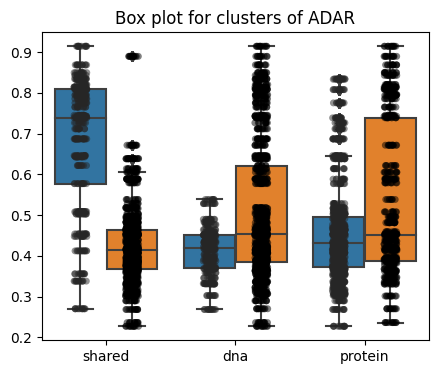

Two-sided p-value for latent_shared_dec clusters: 1.288058428215235e-262
Two-sided p-value for latent_dna_dec clusters: 4.225472590273796e-24
Two-sided p-value for latent_protein_dec clusters: 2.203299726649847e-21
ATE1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


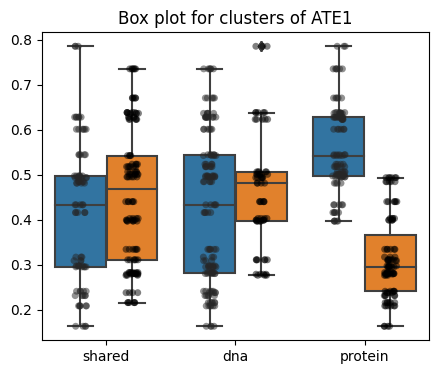

Two-sided p-value for latent_shared_dec clusters: 0.07605745963415633
Two-sided p-value for latent_dna_dec clusters: 0.08026769415111212
Two-sided p-value for latent_protein_dec clusters: 1.9460416514236457e-47
ELAC2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


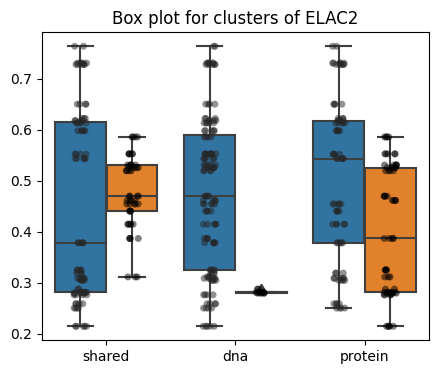

Two-sided p-value for latent_shared_dec clusters: 0.28660279499727714
Two-sided p-value for latent_dna_dec clusters: 1.5526631862608043e-05
Two-sided p-value for latent_protein_dec clusters: 0.000159064996018552
ABCB7


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


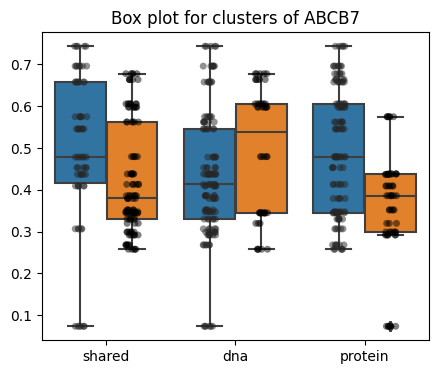

Two-sided p-value for latent_shared_dec clusters: 0.002033111802940771
Two-sided p-value for latent_dna_dec clusters: 0.025271918171898333
Two-sided p-value for latent_protein_dec clusters: 8.549549667126916e-08
FAM111A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


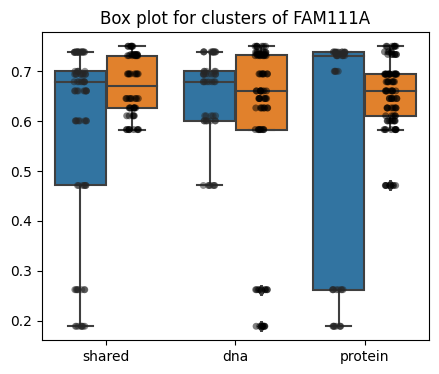

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.000521139284148249
Two-sided p-value for latent_dna_dec clusters: 0.04840992672228817
Two-sided p-value for latent_protein_dec clusters: 0.0001534474723188306
CLNS1A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


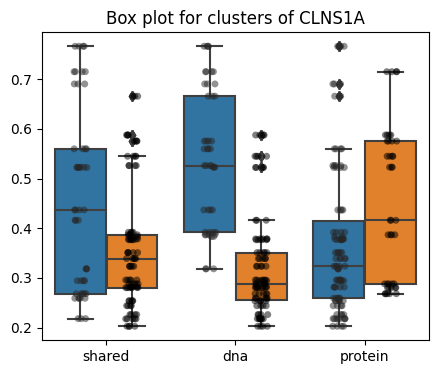

Two-sided p-value for latent_shared_dec clusters: 0.00024096109062025404
Two-sided p-value for latent_dna_dec clusters: 1.1988355199857447e-19
Two-sided p-value for latent_protein_dec clusters: 0.007679493925626075
EARS2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


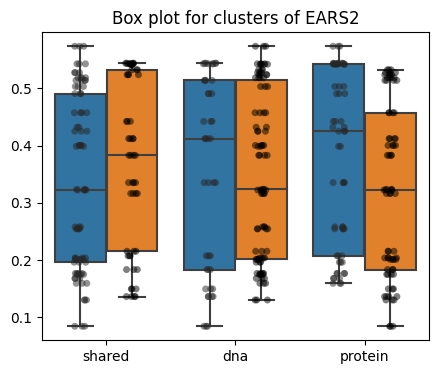

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.14553849844673492
Two-sided p-value for latent_dna_dec clusters: 0.9395619212583751
Two-sided p-value for latent_protein_dec clusters: 0.03788740785792304
DDX39B


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


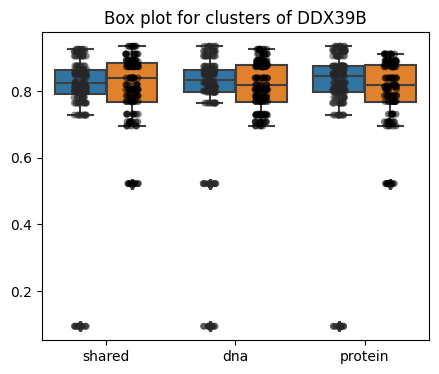

_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Two-sided p-value for latent_shared_dec clusters: 0.11516591931522412
Two-sided p-value for latent_dna_dec clusters: 0.0021109032024934343
Two-sided p-value for latent_protein_dec clusters: 0.853299388906178
CHAMP1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


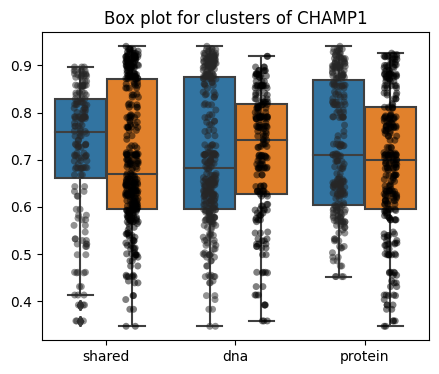

Two-sided p-value for latent_shared_dec clusters: 0.26034268079417683
Two-sided p-value for latent_dna_dec clusters: 0.8084884372315414
Two-sided p-value for latent_protein_dec clusters: 0.005304700329953802
ALG2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
categorical.py (166): Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.


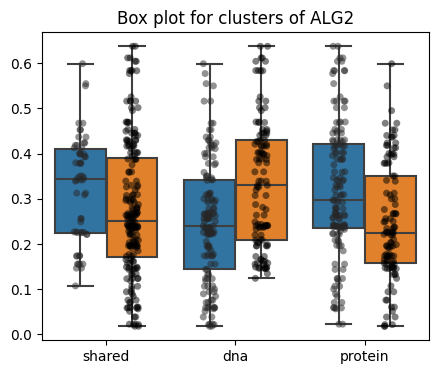

Two-sided p-value for latent_shared_dec clusters: 0.0218852955558194
Two-sided p-value for latent_dna_dec clusters: 8.241977334834225e-07
Two-sided p-value for latent_protein_dec clusters: 6.063222854420352e-05


In [241]:
from sklearn.cluster import KMeans
from scipy.stats import ttest_ind

for pidx in range(25):
    p = cellIDbyCellLine_pNamesUniqueFiltered[allNucProp_stdRank[pidx]]
    print(p)

    # Prepare data for latent_shared_dec
    latent_shared = latent_shared_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_shared = KMeans(n_clusters=2, random_state=0).fit(latent_shared)
    labels_shared = kmeans_shared.labels_
    data_shared = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]

    # Prepare data for latent_dna_dec
    latent_dna = latent_dna_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_dna = KMeans(n_clusters=2, random_state=0).fit(latent_dna)
    labels_dna = kmeans_dna.labels_
    data_dna = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]

    # Prepare data for latent_protein_dec
    latent_protein = latent_protein_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_protein = KMeans(n_clusters=2, random_state=0).fit(latent_protein)
    labels_protein = kmeans_protein.labels_
    data_protein = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]

    # Combine data
    data_combined = np.concatenate([data_shared, data_dna, data_protein])
    labels_combined = np.concatenate([labels_shared, labels_dna, labels_protein])
    latent_names = np.array(['shared'] * len(data_shared) + ['dna'] * len(data_dna) + ['protein'] * len(data_protein))

    # Box plot with data points
    plt.figure(figsize=(5, 4))
    sns.boxplot(x=latent_names, y=data_combined, hue=labels_combined)
    sns.stripplot(x=latent_names, y=data_combined, hue=labels_combined, dodge=True, jitter=True, color='black', alpha=0.5)
    plt.title(f'Box plot for clusters of {p}')
    plt.legend([],[], frameon=False) # Remove legend created by stripplot
    plt.show()

    # Compute two-sided p-value
    group1_shared = data_shared[labels_shared == 0]
    group2_shared = data_shared[labels_shared == 1]
    t_stat_shared, p_val_shared = ttest_ind(group1_shared, group2_shared)
    print(f"Two-sided p-value for latent_shared_dec clusters: {p_val_shared}")

    group1_dna = data_dna[labels_dna == 0]
    group2_dna = data_dna[labels_dna == 1]
    t_stat_dna, p_val_dna = ttest_ind(group1_dna, group2_dna)
    print(f"Two-sided p-value for latent_dna_dec clusters: {p_val_dna}")

    group1_protein = data_protein[labels_protein == 0]
    group2_protein = data_protein[labels_protein == 1]
    t_stat_protein, p_val_protein = ttest_ind(group1_protein, group2_protein)
    print(f"Two-sided p-value for latent_protein_dec clusters: {p_val_protein}")

In [307]:
exampleSavePath=os.path.join(plotsavepath_train,'nucProp_clusterExamples_withProtein')
nExamples=20
imgSize=128
for pidx in range(25):
    p = cellIDbyCellLine_pNamesUniqueFiltered[allNucProp_stdRank[pidx]]
    print(p)
    
    # Prepare data for latent_shared_dec
    latent_shared = latent_shared_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_shared = KMeans(n_clusters=2, random_state=0).fit(latent_shared)
    labels_shared = kmeans_shared.labels_
    data_shared = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_shared==0]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_shared_0.jpg'),plotExample)
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_shared==1]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_shared_1.jpg'),plotExample)

    # Prepare data for latent_dna_dec
    latent_dna = latent_dna_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_dna = KMeans(n_clusters=2, random_state=0).fit(latent_dna)
    labels_dna = kmeans_dna.labels_
    data_dna = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_dna==0]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_dna_0.jpg'),plotExample)
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_dna==1]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_dna_1.jpg'),plotExample)

    # Prepare data for latent_protein_dec
    latent_protein = latent_protein_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    kmeans_protein = KMeans(n_clusters=2, random_state=0).fit(latent_protein)
    labels_protein = kmeans_protein.labels_
    data_protein = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_protein==0]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_protein_0.jpg'),plotExample)
    plotExample=np.zeros((nExamples*(imgSize+2),3*(imgSize+2)))
    imgIdx=np.arange(allImages.shape[0])[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p][labels_protein==1]
    np.random.seed(3)
    np.random.shuffle(imgIdx)
    plotIdx=imgIdx[:min(imgIdx.size,nExamples)]
    print('sampled')
    for plotIdx_idx in range(plotIdx.size):
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,:imgSize]=allImages[plotIdx[plotIdx_idx],0]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2):(imgSize+2)+imgSize]=allImages[plotIdx[plotIdx_idx],1]
        plotExample[plotIdx_idx*(imgSize+2):plotIdx_idx*(imgSize+2)+imgSize,(imgSize+2)*2:(imgSize+2)*2+imgSize]=allProteinImages[plotIdx[plotIdx_idx]]
    plt.imsave(os.path.join(exampleSavePath,p+'_protein_1.jpg'),plotExample)



ABCB8


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
CPSF6


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ABCC8


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
FTSJ3


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
FAM131A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
AASS


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ETFA


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ABAT


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
DDX21


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ADCY5


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
DDX1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
A1CF


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
DDB1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
C8orf59


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
CIZ1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ADAR


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ATE1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ELAC2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ABCB7


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
FAM111A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
CLNS1A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
EARS2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
DDX39B


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
CHAMP1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled
ALG2


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


sampled
sampled


In [36]:
from sklearn.cluster import KMeans
from scipy.stats import ttest_ind

# Define the number of clusters and random states
n_runs = 5
nsig=4
num_latents = 3
num_proteins = 25
abs_diff_means = np.zeros((num_proteins, num_latents))
significant_entries = np.zeros((num_proteins, num_latents), dtype=int)
diff_thresh=0.1

bonferroni_threshold = 0.05 / (num_proteins * num_latents)/3

for pidx in range(25):
    p = cellIDbyCellLine_pNamesUniqueFiltered[allNucProp_stdRank[pidx]]
    print(p)

    # Prepare data for each latent
    latent_data = {
        'shared': latent_shared_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy(),
        'dna': latent_dna_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy(),
        'protein': latent_protein_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    }

    for latent_name, latent in latent_data.items():
        all_abs_diff_means = []
        all_significant_entries = []

        for run in range(n_runs):
            kmeans = KMeans(n_clusters=2, random_state=run).fit(latent)
            labels = kmeans.labels_
            data = allNucProp[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p]

            group1 = data[labels == 0]
            group2 = data[labels == 1]
            abs_diff_mean = np.abs(np.mean(group1) - np.mean(group2))
            all_abs_diff_means.append(abs_diff_mean)

            _, p_val = ttest_ind(group1, group2)
            significant = p_val < bonferroni_threshold
            all_significant_entries.append(significant)

        # Average the absolute differences
        avg_abs_diff_means = np.mean(all_abs_diff_means)
        abs_diff_means[pidx, {'shared': 0, 'dna': 1, 'protein': 2}[latent_name]] = avg_abs_diff_means

        # Determine if there was any significant result across all runs
        sigDiff=np.array(all_abs_diff_means)>diff_thresh
        significant_entries[pidx, {'shared': 0, 'dna': 1, 'protein': 2}[latent_name]] = np.sum(np.logical_and(all_significant_entries,sigDiff))



ABCB8


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

CPSF6


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ABCC8


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

FTSJ3


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

FAM131A


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

AASS


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ETFA


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ABAT


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

DDX21


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ADCY5


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

DDX1


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

A1CF


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

DDB1


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

C8orf59


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

CIZ1


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ADAR


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ATE1


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ELAC2


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ABCB7


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

FAM111A


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

CLNS1A


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

EARS2


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

DDX39B


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

CHAMP1


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

ALG2


/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/xinyi/anaconda3/envs/subcell_loc2/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicit

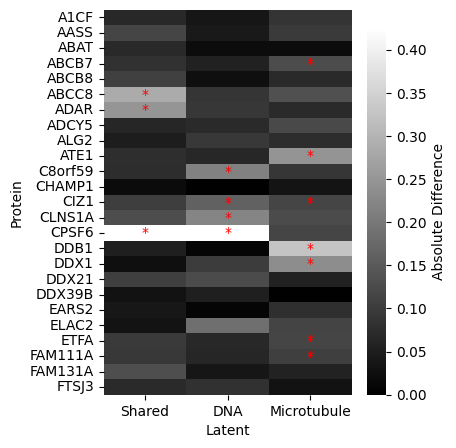

In [38]:
filtered_significant_entries = significant_entries>nsig
filtered_proteins = [cellIDbyCellLine_pNamesUniqueFiltered[allNucProp_stdRank[i]] for i in range(25)]

filtered_proteins_array = np.array(filtered_proteins)

# Sort abs_diff_means and filtered_proteins by protein names (row names) alphabetically
sorted_indices = np.argsort(filtered_proteins_array)
abs_diff_means = abs_diff_means[sorted_indices, :]
filtered_proteins_sorted = filtered_proteins_array[sorted_indices]
filtered_significant_entries = filtered_significant_entries[sorted_indices, :]

# Plotting the heatmap
plt.figure(figsize=(4, 5))
sns.heatmap(abs_diff_means, cmap='gray', cbar_kws={'label': 'Absolute Difference', 'extend': 'max'}, vmin=0, vmax=0.425)

# Adding red asterisks for significant entries
for i in range(abs_diff_means.shape[0]):
    for j in range(abs_diff_means.shape[1]):
        if filtered_significant_entries[i, j]:
            plt.text(j + 0.5, i + 0.5, '*', color='red', ha='center', va='center')

# Labeling axes
plt.xlabel('Latent')
plt.ylabel('Protein')

# Customize x-ticks and y-ticks
plt.xticks(ticks=np.arange(abs_diff_means.shape[1]) + 0.5, labels=['Shared', 'DNA', 'Microtubule'])
plt.yticks(ticks=np.arange(abs_diff_means.shape[0]) + 0.5, labels=filtered_proteins_sorted, rotation=0)

# Save the figure with tight bounding box
plt.savefig(os.path.join(plotsavepath_train, 'nucProp_clusterDiff_top25_filtered_5runs_allprots_ordered.pdf'), bbox_inches='tight')

# Show the plot
plt.show()

In [39]:
bonferroni_threshold 

0.00022222222222222226

In [40]:
(num_proteins * num_latents)*3

225

ATE1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

CPSF6


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

CIZ1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

DDB1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

DDX1


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

FAM111A


_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
_kmeans.py (870): The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explic

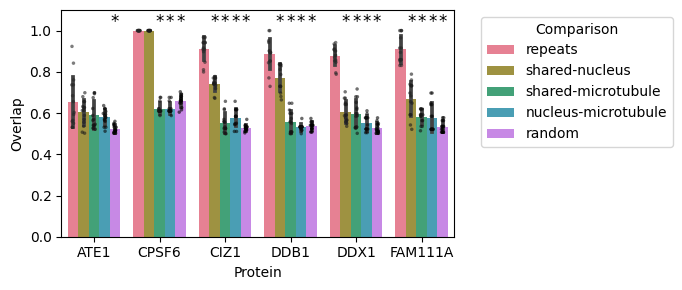

In [324]:
# Define the number of clusters and random states
n_runs = 15
num_proteins = 25
p2plot=['ATE1','CPSF6','CIZ1','DDB1','DDX1','FAM111A']
overlapRes={}

bonferroni_threshold = 0.05 / (num_proteins * num_latents)/2

compnames=['repeats','shared-nucleus','shared-microtubule','nucleus-microtubule','random']
for pidx in range(len(p2plot)):
    p = p2plot[pidx]
    print(p)
    
    # Prepare data for each latent
    latent_shared=latent_shared_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    latent_dna=latent_dna_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()
    latent_protein=latent_protein_dec.weight[trainIdx_all][cellIDbyCellLine_pNamesFiltered_comb[trainIdx_all] == p].detach().numpy()

    overlapRes[p]=np.zeros((n_runs,5))
    kmeans = KMeans(n_clusters=2, random_state=100).fit(latent_shared)
    labels_shared_0 = kmeans.labels_
    for run in range(n_runs):
        kmeans = KMeans(n_clusters=2, random_state=run).fit(latent_shared)
        labels_shared = kmeans.labels_
        
        kmeans = KMeans(n_clusters=2, random_state=run).fit(latent_dna)
        labels_dna = kmeans.labels_
        
        kmeans = KMeans(n_clusters=2, random_state=run).fit(latent_protein)
        labels_protein = kmeans.labels_
        
        overlapRes[p][run,0]=max(np.sum(labels_shared_0==labels_shared),np.sum(labels_shared_0!=labels_shared))/labels_shared.size
        overlapRes[p][run,1]=max(np.sum(labels_dna==labels_shared),np.sum(labels_dna!=labels_shared))/labels_shared.size
        overlapRes[p][run,2]=max(np.sum(labels_protein==labels_shared),np.sum(labels_protein!=labels_shared))/labels_shared.size
        overlapRes[p][run,3]=max(np.sum(labels_dna==labels_protein),np.sum(labels_dna!=labels_protein))/labels_shared.size
        np.random.seed(run)
        labels_shared_random=np.copy(labels_shared)
        labels_shared_random1=np.copy(labels_shared)
        np.random.shuffle(labels_shared_random)
        np.random.seed(run+1)
        np.random.shuffle(labels_shared_random1)
        overlapRes[p][run,4]=max(np.sum(labels_shared_random==labels_shared_random1),np.sum(labels_shared_random!=labels_shared_random1))/labels_shared.size


results = []
for p in p2plot:
    for run in range(n_runs):
        for i, compname in enumerate(compnames):
            results.append({
                'Protein': p,
                'Comparison': compname,
                'Overlap': overlapRes[p][run, i]
            })

# Convert the list of results into a DataFrame
df = pd.DataFrame(results)

# Set the bar plot with error bars
plt.figure(figsize=(7, 3))
barplot = sns.barplot(x='Protein', y='Overlap', hue='Comparison', data=df, errorbar='sd', palette='husl', dodge=True)

# Overlay individual data points without legend
sns.stripplot(x='Protein', y='Overlap', hue='Comparison', data=df, 
              jitter=True, dodge=True, marker='.', color='black', alpha=0.6, legend=False)

# Calculate and annotate asterisks for significant p-values separately for each protein
for p in p2plot:
    df_p = df[df['Protein'] == p]
    y_max = df_p['Overlap'].max()
    
    # Get the positions of the bars
    bars = barplot.patches
    
    # Iterate over comparisons except "repeats"
    for comp_idx, comp in enumerate(compnames[1:], start=1):
        
        group1 = df_p[df_p['Comparison'] == 'repeats']['Overlap']
        group2 = df_p[df_p['Comparison'] == comp]['Overlap']

        # Perform t-test
        t_stat, p_val = ttest_ind(group1, group2)

        # Bonferroni correction for multiple comparisons
        p_val_corrected = min(p_val * (len(compnames) - 1), 1.0)

        # Determine if the p-value is significant
        if p_val_corrected < 0.05:
            # Calculate x-position and y-position for the asterisk
            x_pos = bars[p2plot.index(p)+comp_idx*6].get_x() + bars[p2plot.index(p)+comp_idx*6].get_width() / 2
            y_pos = bars[comp_idx].get_height() + 0.4

#             print(comp_idx, comp, x_pos, y_max)
            # Annotate with an asterisk above the bar
            plt.text(x_pos, 1, '*', ha='center', va='bottom', color='k', fontsize=12)

# Adjusting the plot
plt.ylim(0, df['Overlap'].max() + 0.1)  # Increase the y-limit to make space for asterisks
plt.ylabel('Overlap')
# plt.title('Overlap Across Latent Spaces for Selected Proteins')
plt.legend(title='Comparison', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.savefig(os.path.join(plotsavepath_train,'nucProp_clusterOverlap.pdf'), bbox_inches='tight')
# Show the plot
plt.show()
